# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return nn.functional.one_hot(labels, n_classes)
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [43]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(), y.float()), 1)
    #### END CODE HERE ####
    return combined

In [44]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [45]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [46]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [47]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [48]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [49]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.2193349735736847, discriminator loss: 0.2520254644304514


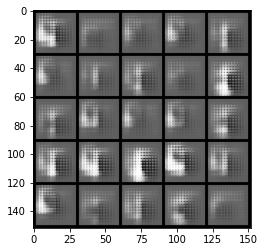

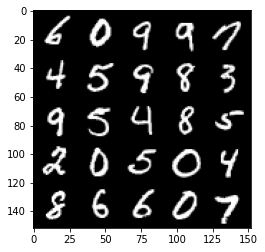

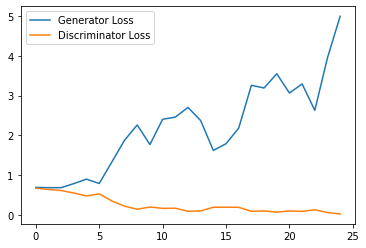

Step 1000: Generator loss: 4.430400548219681, discriminator loss: 0.07499430203437805


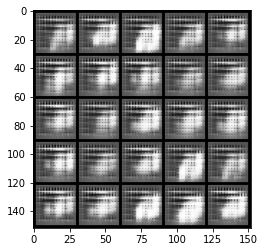

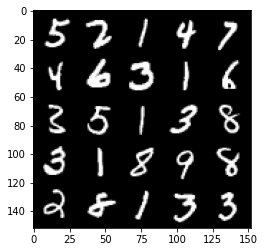

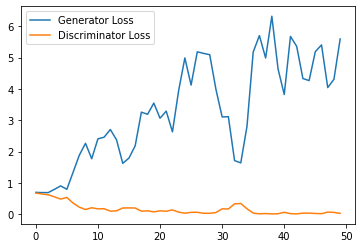

Step 1500: Generator loss: 5.233404139518738, discriminator loss: 0.040082259664312


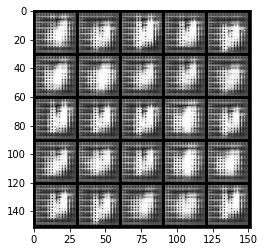

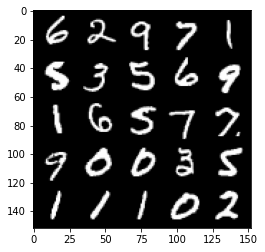

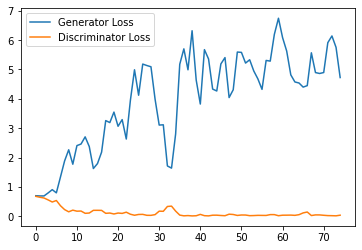

Step 2000: Generator loss: 5.206858231544494, discriminator loss: 0.020312892392277716


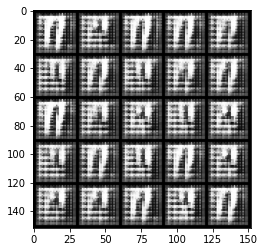

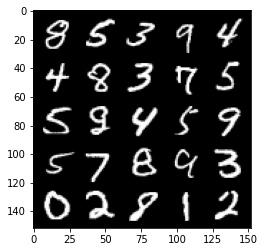

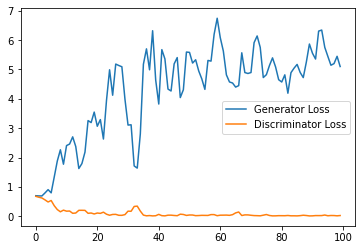

Step 2500: Generator loss: 5.3047870583534245, discriminator loss: 0.023023427374660968


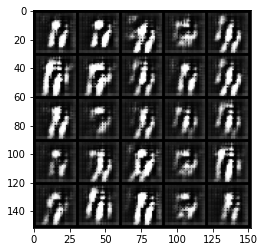

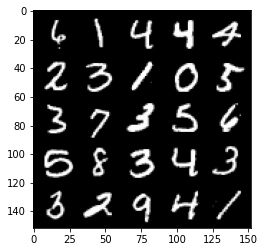

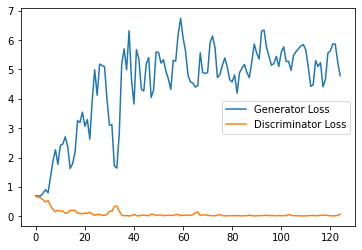

Step 3000: Generator loss: 4.308024135112762, discriminator loss: 0.06897596574947237


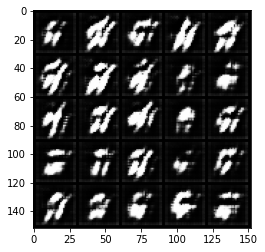

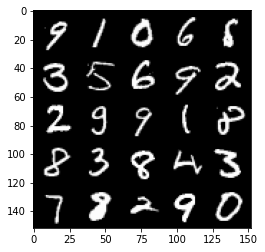

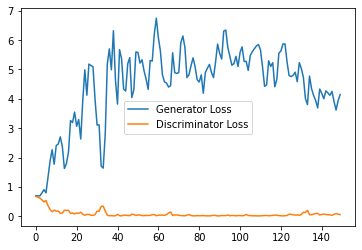

Step 3500: Generator loss: 3.5934213347435, discriminator loss: 0.117569021910429


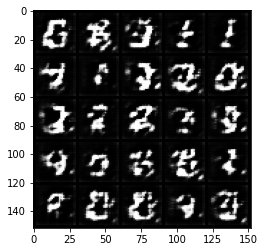

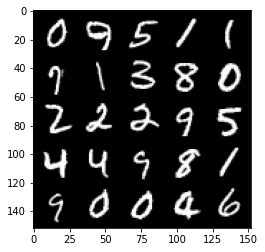

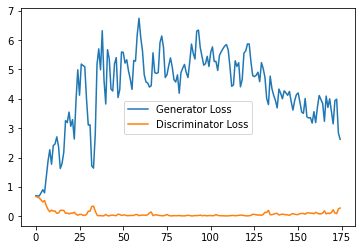

Step 4000: Generator loss: 3.0984868998527526, discriminator loss: 0.21058421956002712


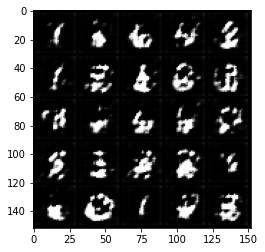

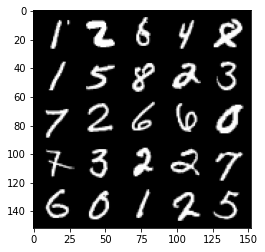

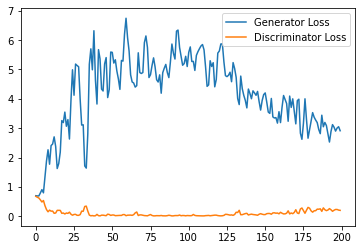

Step 4500: Generator loss: 2.7151401851177215, discriminator loss: 0.2651173879057169


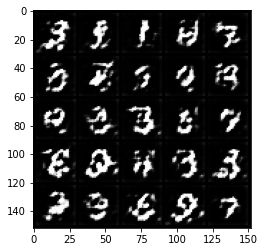

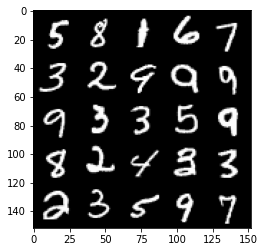

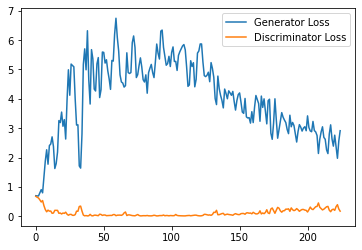

Step 5000: Generator loss: 2.4673689379692076, discriminator loss: 0.2630979183316231


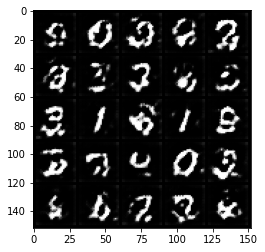

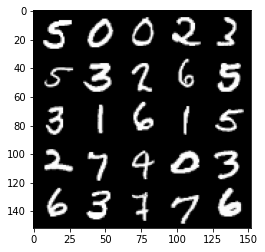

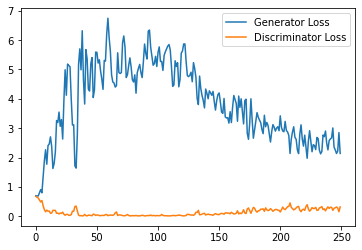

Step 5500: Generator loss: 2.34451074719429, discriminator loss: 0.2608710492402315


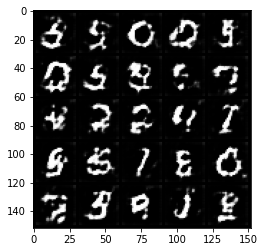

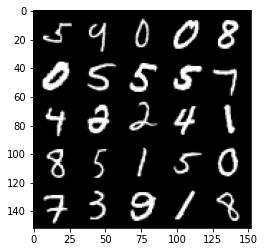

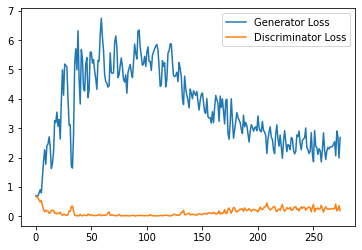

Step 6000: Generator loss: 2.2987149159908293, discriminator loss: 0.2805711799263954


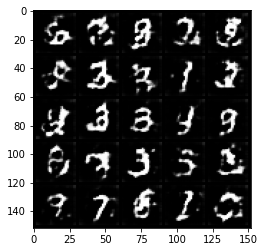

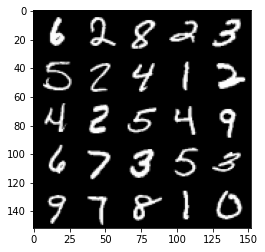

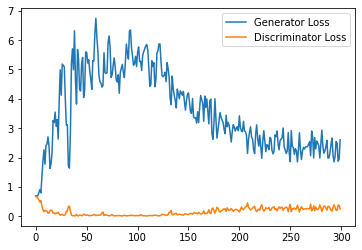

Step 6500: Generator loss: 2.254557868242264, discriminator loss: 0.3029694755375385


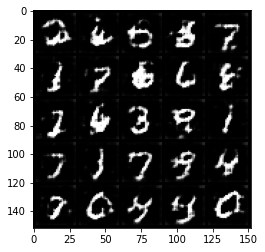

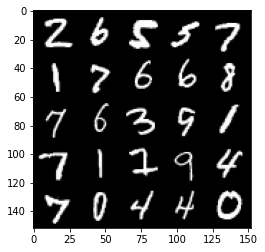

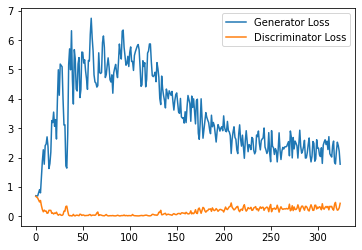

Step 7000: Generator loss: 2.0683266179561617, discriminator loss: 0.3155924891978502


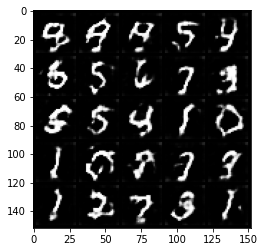

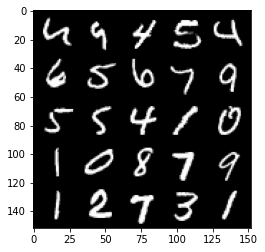

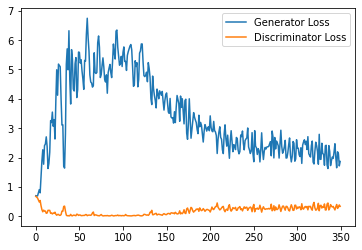

Step 7500: Generator loss: 1.910085440158844, discriminator loss: 0.34361719438433647


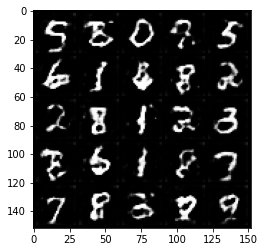

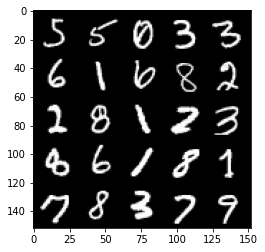

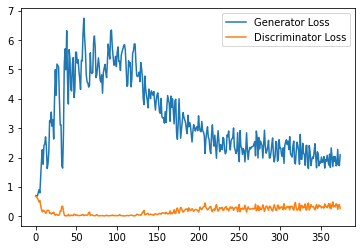

Step 8000: Generator loss: 1.8407490894794465, discriminator loss: 0.38080352792143823


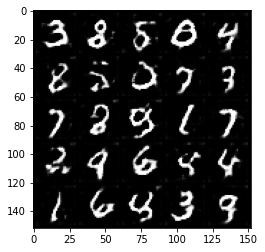

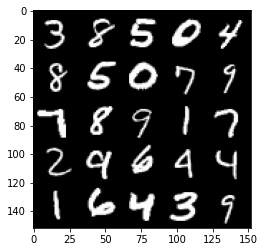

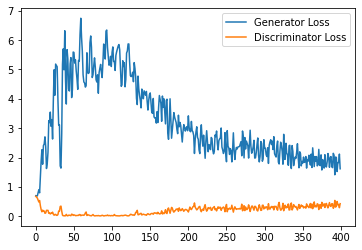

Step 8500: Generator loss: 1.7140197224617004, discriminator loss: 0.4161460929512978


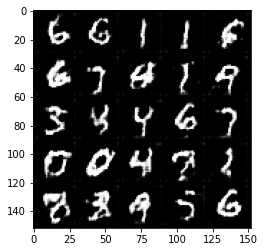

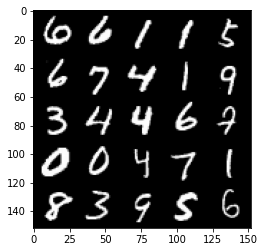

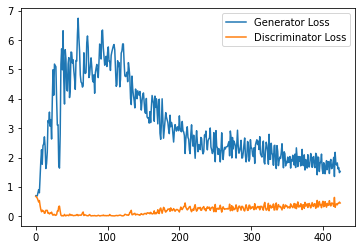

Step 9000: Generator loss: 1.6642877931594848, discriminator loss: 0.41776797172427177


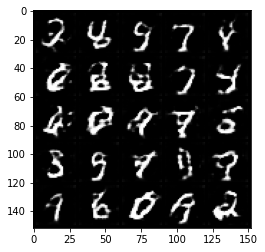

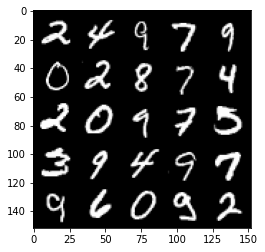

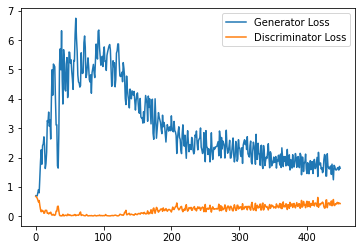

Step 9500: Generator loss: 1.5524569256305694, discriminator loss: 0.4478216374516487


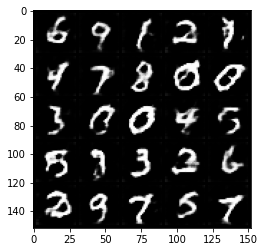

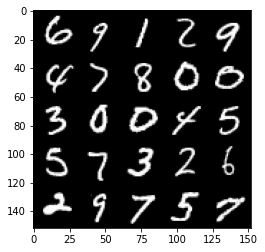

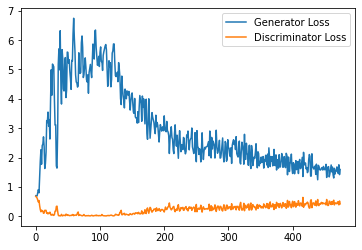

Step 10000: Generator loss: 1.5219405696392059, discriminator loss: 0.460736212849617


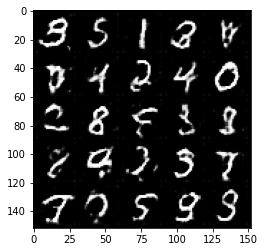

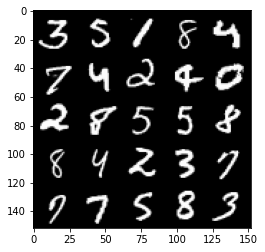

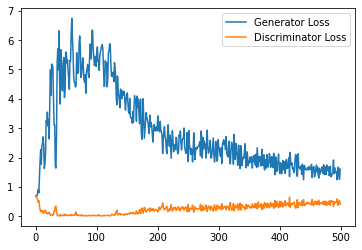

Step 10500: Generator loss: 1.424595887541771, discriminator loss: 0.47551854062080384


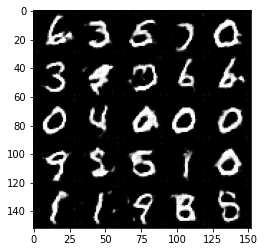

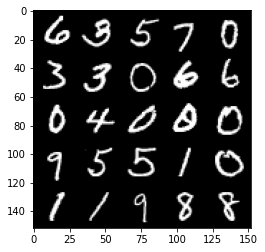

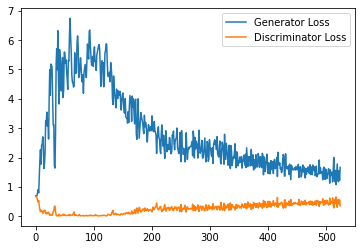

Step 11000: Generator loss: 1.3745381289720535, discriminator loss: 0.4931567339897156


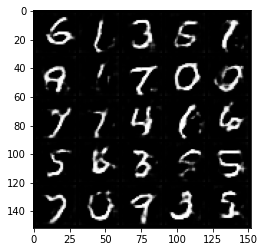

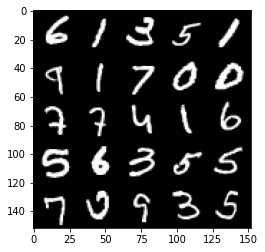

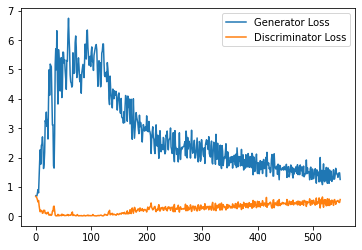

Step 11500: Generator loss: 1.3659686571359635, discriminator loss: 0.5044810962080956


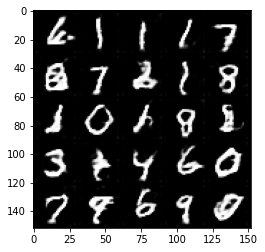

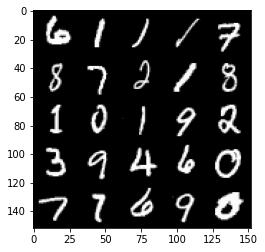

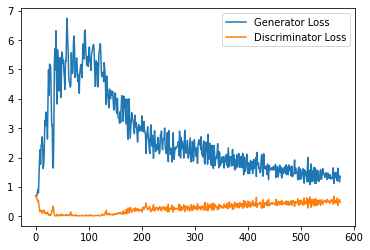

Step 12000: Generator loss: 1.3594547770023346, discriminator loss: 0.5165569270253182


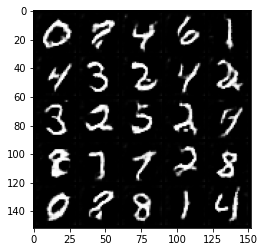

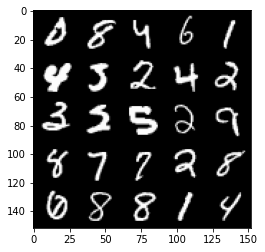

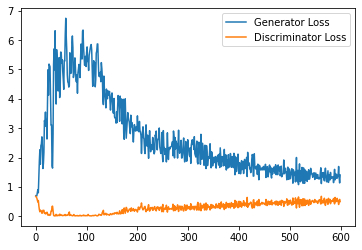

Step 12500: Generator loss: 1.3588762730360031, discriminator loss: 0.5182990611195565


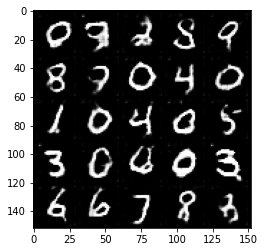

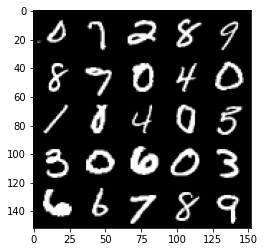

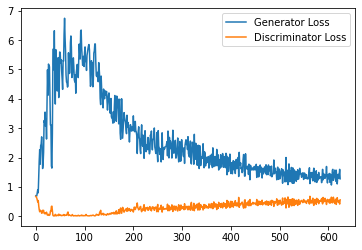

Step 13000: Generator loss: 1.2768326797485352, discriminator loss: 0.5378264446854591


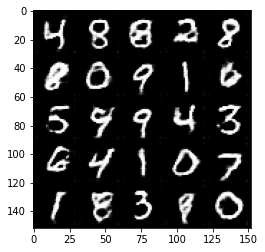

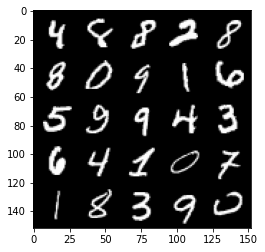

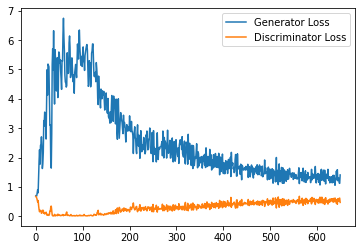

Step 13500: Generator loss: 1.2863481727838517, discriminator loss: 0.5225147088170051


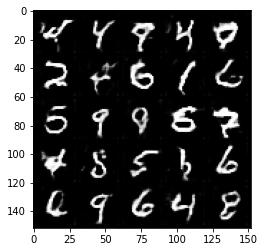

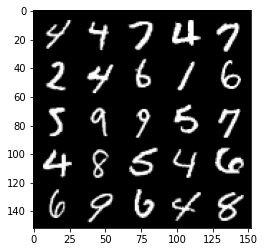

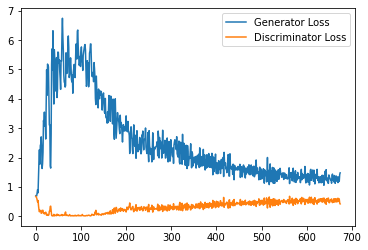

Step 14000: Generator loss: 1.2296625281572342, discriminator loss: 0.5403696892261505


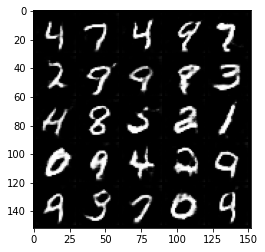

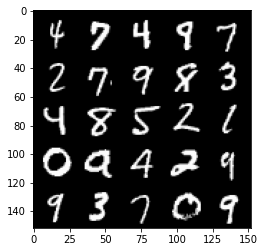

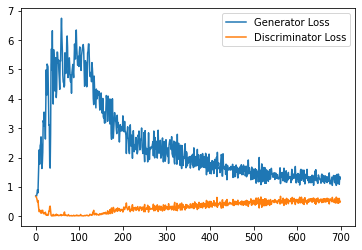

Step 14500: Generator loss: 1.2039885239601136, discriminator loss: 0.5447639282941819


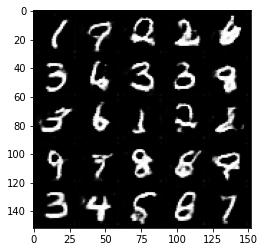

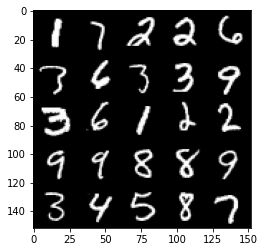

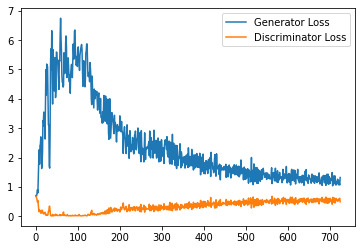

Step 15000: Generator loss: 1.1854753804206848, discriminator loss: 0.5602131106257439


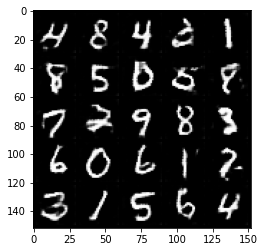

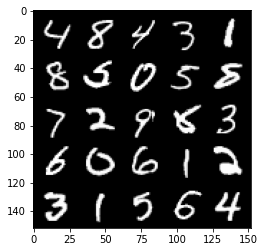

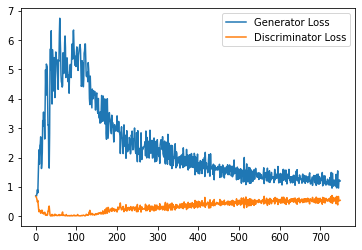

Step 15500: Generator loss: 1.181561339855194, discriminator loss: 0.5607489837408066


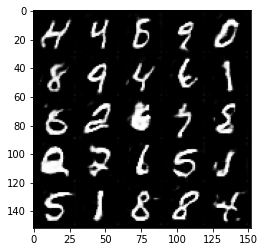

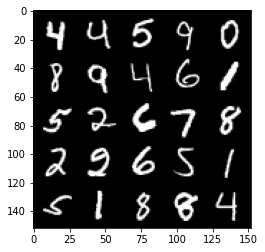

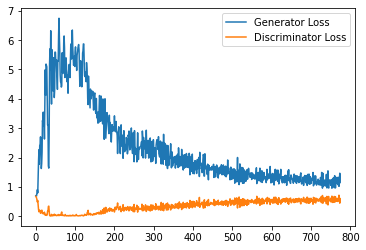

Step 16000: Generator loss: 1.1826064369678497, discriminator loss: 0.5766827899217606


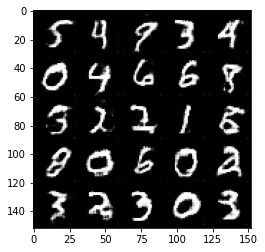

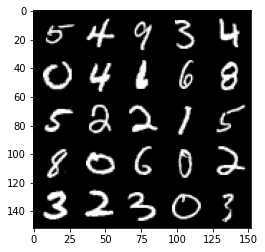

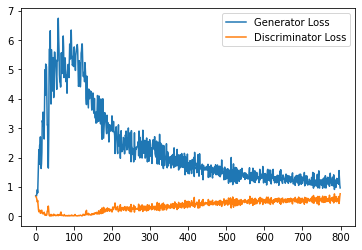

Step 16500: Generator loss: 1.1668614270687103, discriminator loss: 0.5631440581083298


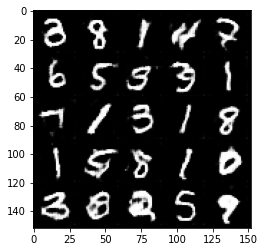

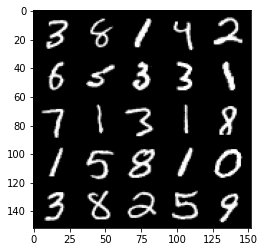

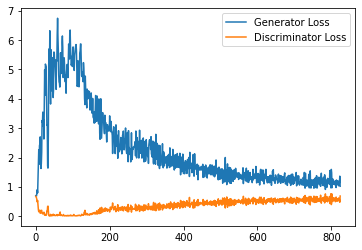

Step 17000: Generator loss: 1.1579041378498078, discriminator loss: 0.5731763108968735


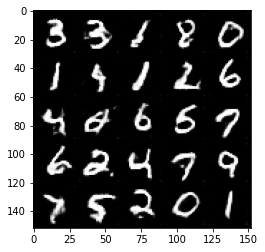

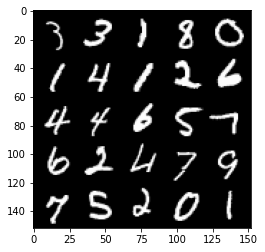

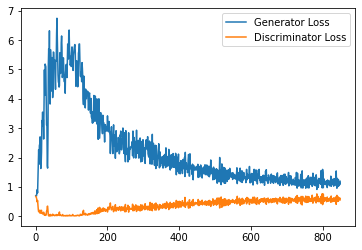

Step 17500: Generator loss: 1.1567520796060562, discriminator loss: 0.5821660087108612


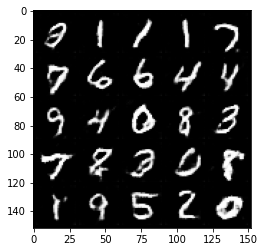

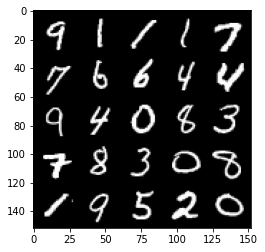

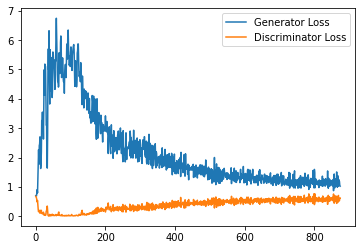

Step 18000: Generator loss: 1.0755128654241561, discriminator loss: 0.5826422204971313


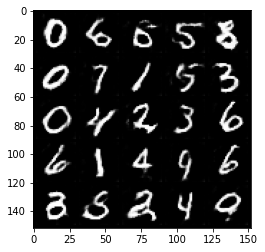

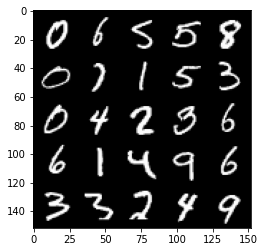

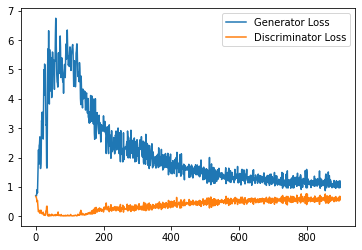

Step 18500: Generator loss: 1.129368496656418, discriminator loss: 0.5906377406716347


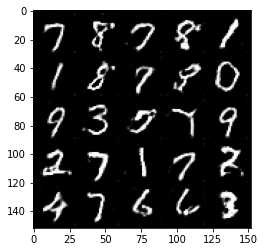

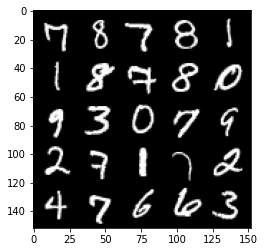

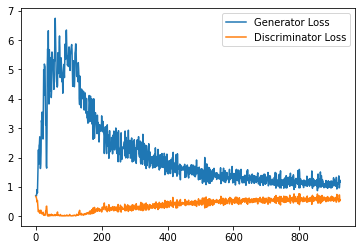

Step 19000: Generator loss: 1.0910254616737365, discriminator loss: 0.5924164806008339


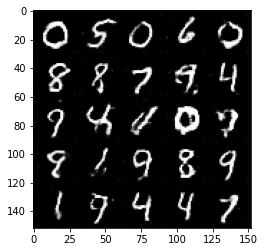

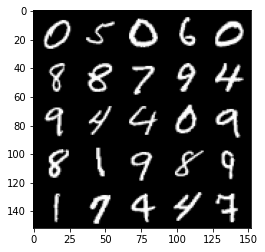

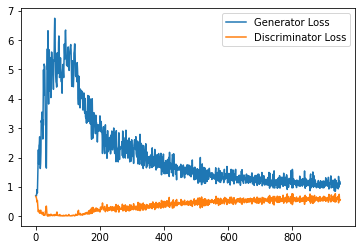

Step 19500: Generator loss: 1.0517031447887422, discriminator loss: 0.5907973920702935


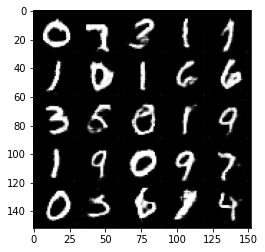

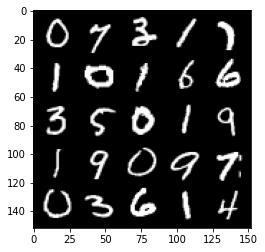

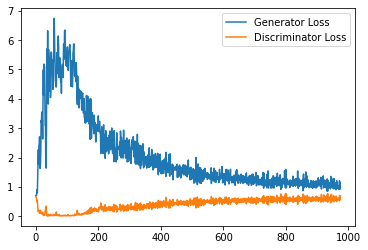

Step 20000: Generator loss: 1.0960200111865996, discriminator loss: 0.5830797851085663


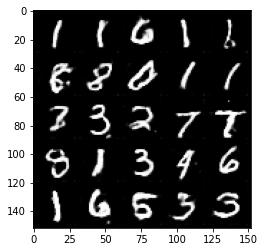

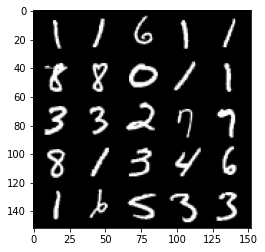

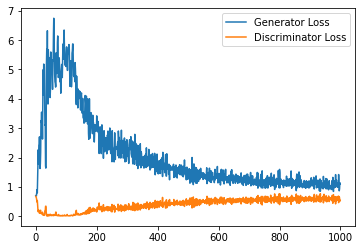

Step 20500: Generator loss: 1.0345963445901871, discriminator loss: 0.58921356600523


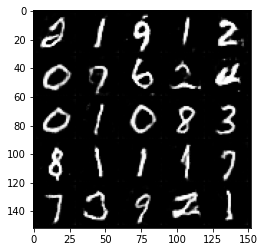

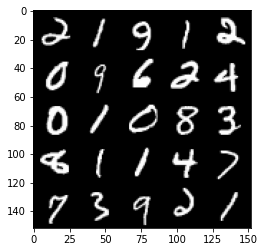

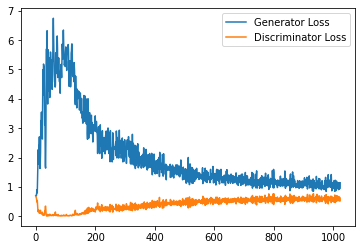

Step 21000: Generator loss: 1.0741130995750428, discriminator loss: 0.5981295472979545


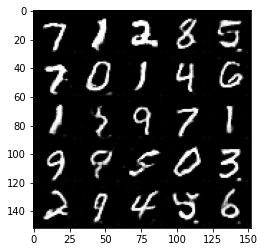

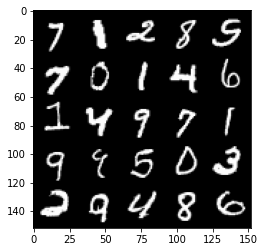

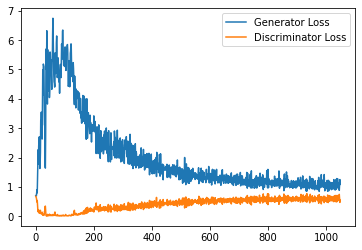

Step 21500: Generator loss: 1.0569955891370773, discriminator loss: 0.5949384816884995


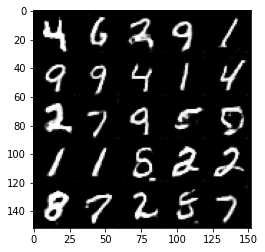

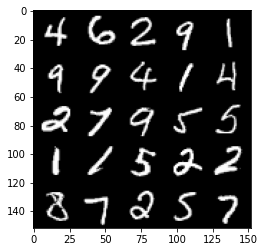

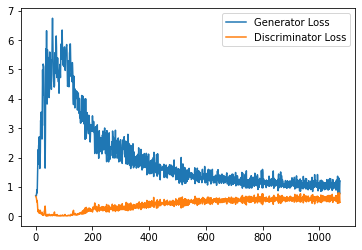

Step 22000: Generator loss: 0.9980359153747559, discriminator loss: 0.5976208124756813


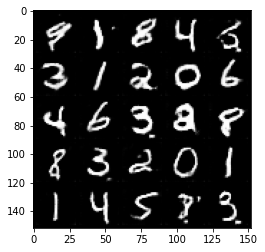

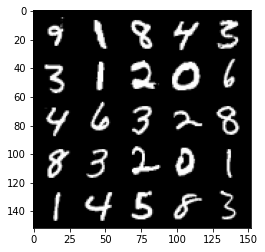

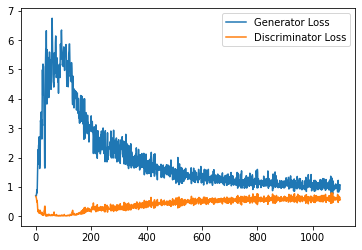

Step 22500: Generator loss: 1.0585101029872894, discriminator loss: 0.5974960034489631


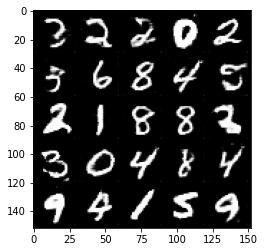

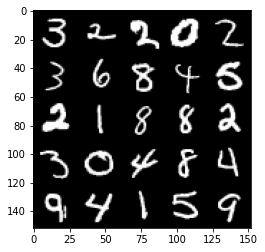

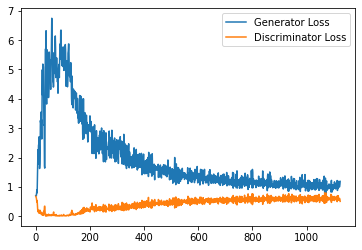

Step 23000: Generator loss: 1.017407433629036, discriminator loss: 0.5998721998333931


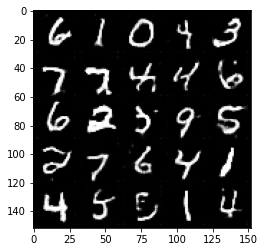

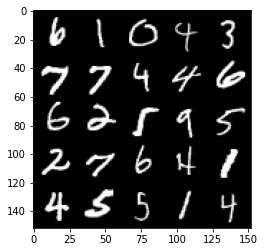

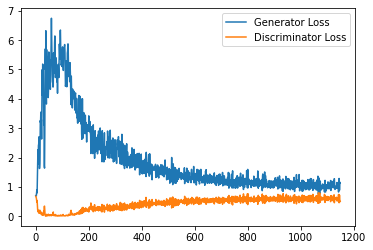

Step 23500: Generator loss: 0.9958527746200562, discriminator loss: 0.6015018063187599


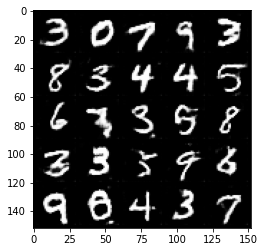

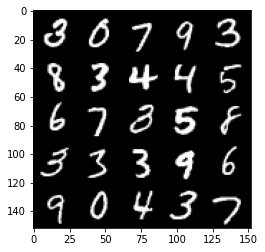

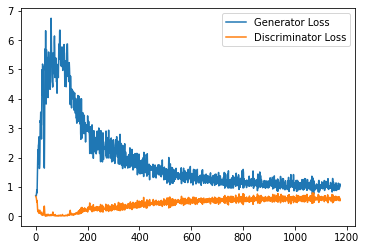

Step 24000: Generator loss: 1.0122146235704421, discriminator loss: 0.607594985127449


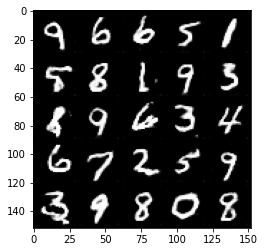

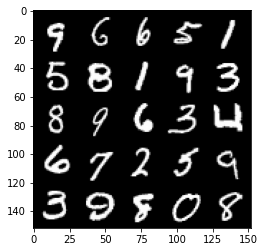

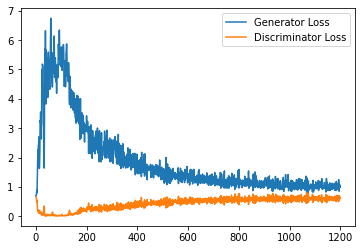

Step 24500: Generator loss: 1.0217070338726044, discriminator loss: 0.6098506049513817


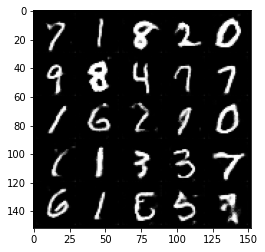

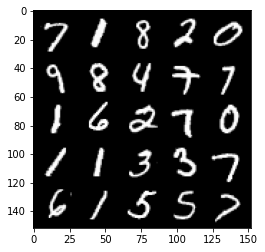

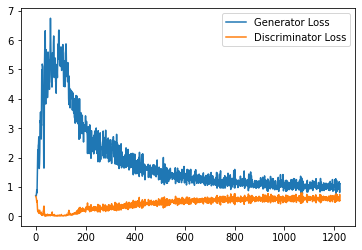

Step 25000: Generator loss: 1.0033153674602509, discriminator loss: 0.6087794596552849


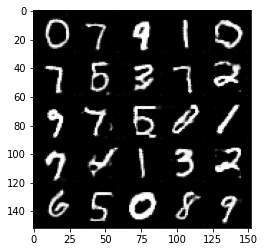

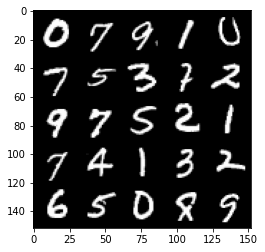

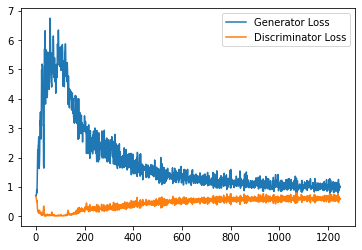

Step 25500: Generator loss: 0.9673965867757798, discriminator loss: 0.6132062632441521


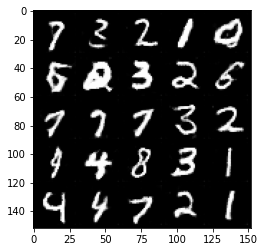

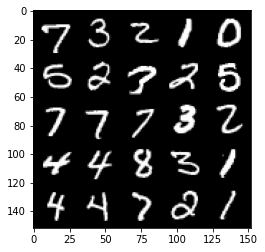

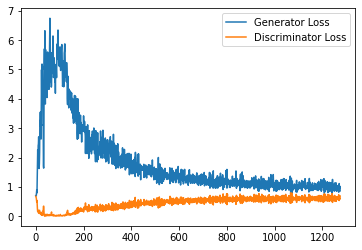

Step 26000: Generator loss: 0.9839412525892258, discriminator loss: 0.6092059711813926


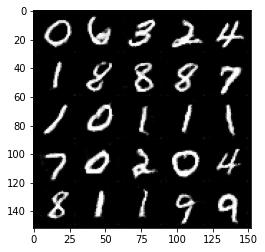

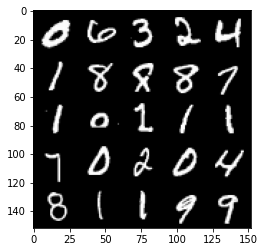

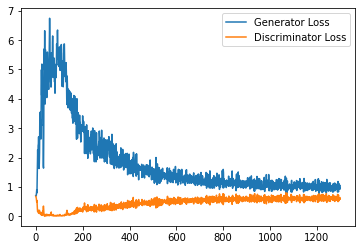

Step 26500: Generator loss: 1.0007528488636017, discriminator loss: 0.6102603486776352


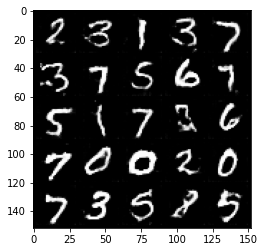

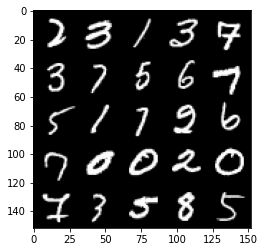

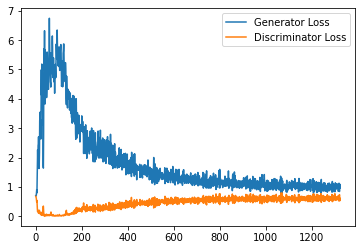

Step 27000: Generator loss: 0.9816878135204316, discriminator loss: 0.6175380957722664


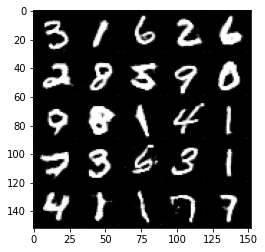

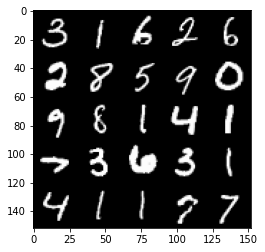

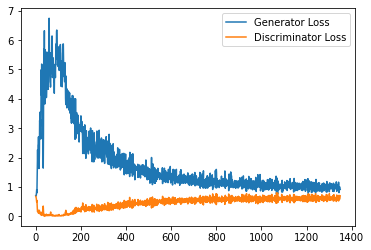

Step 27500: Generator loss: 0.9602133487462997, discriminator loss: 0.6144518238306046


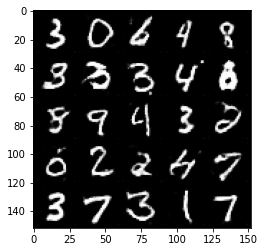

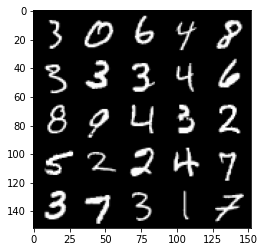

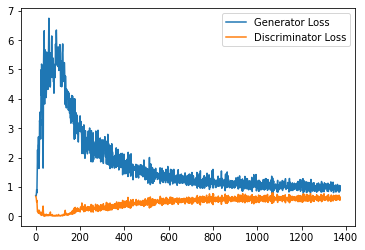

Step 28000: Generator loss: 0.9603188189268113, discriminator loss: 0.6196082426905632


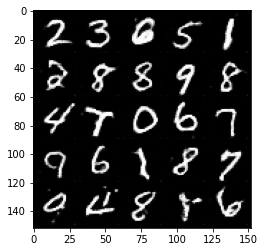

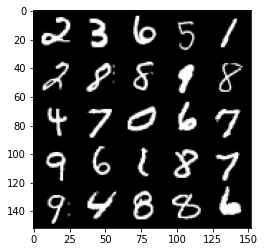

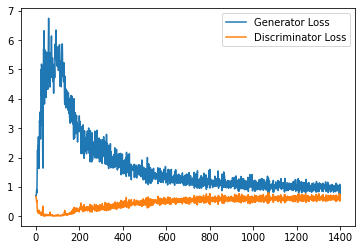

Step 28500: Generator loss: 0.9668768107891083, discriminator loss: 0.61631356549263


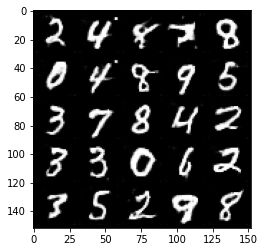

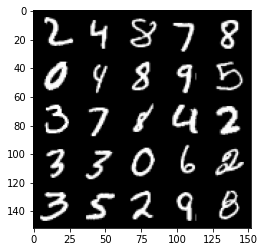

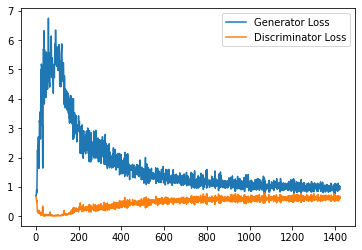

Step 29000: Generator loss: 0.9992340641021729, discriminator loss: 0.6193853008747101


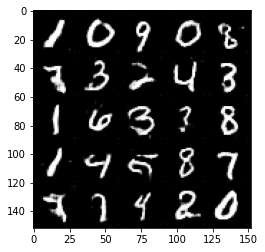

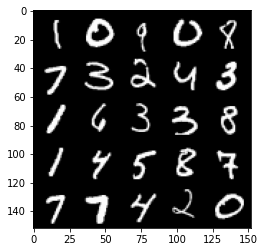

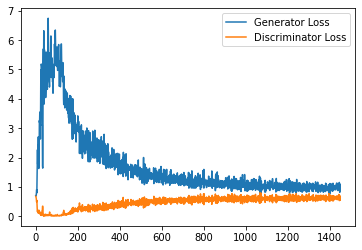

Step 29500: Generator loss: 0.9585885210037232, discriminator loss: 0.6259442220926285


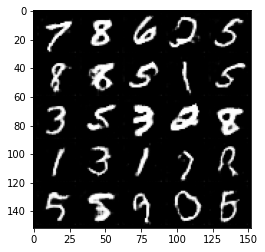

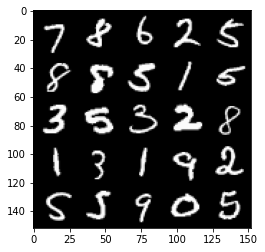

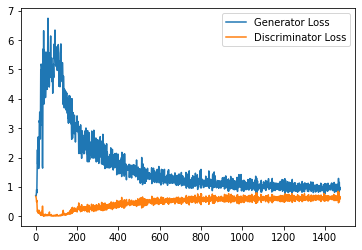

Step 30000: Generator loss: 0.9457914583683014, discriminator loss: 0.620015580534935


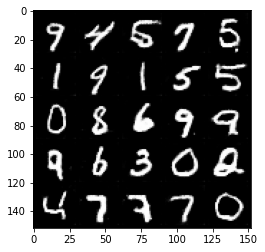

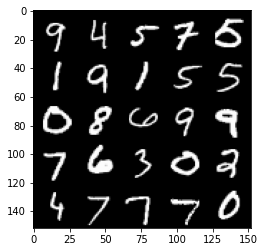

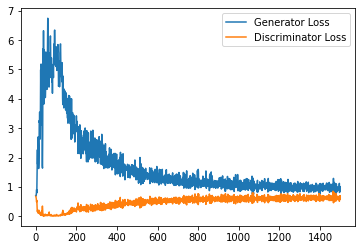

Step 30500: Generator loss: 0.9815088450908661, discriminator loss: 0.6217774994373322


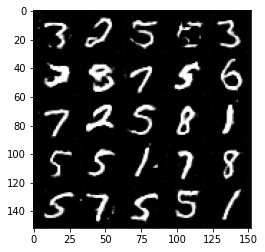

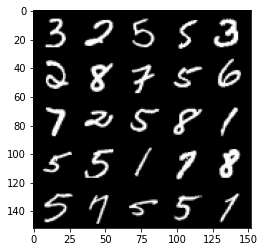

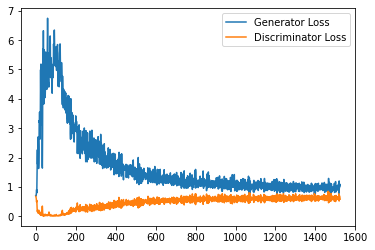

Step 31000: Generator loss: 0.9618756164312363, discriminator loss: 0.6220431956648826


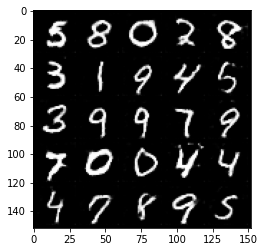

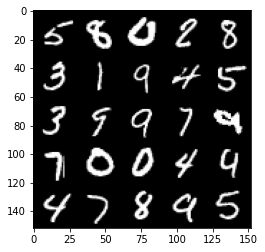

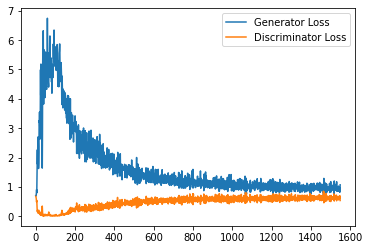

Step 31500: Generator loss: 0.9638717188835144, discriminator loss: 0.6205534845590591


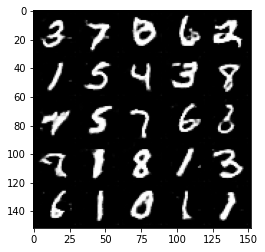

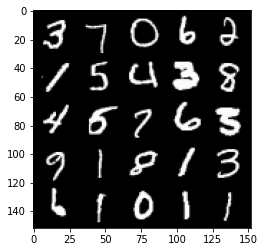

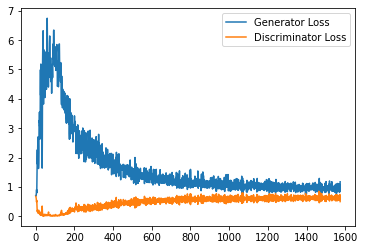

Step 32000: Generator loss: 0.9374735885858536, discriminator loss: 0.6282557194232941


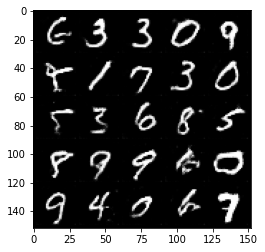

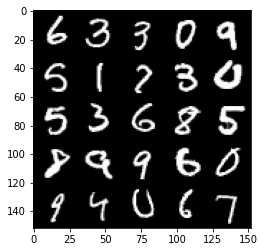

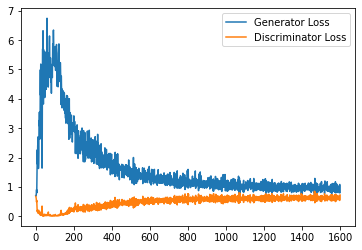

Step 32500: Generator loss: 0.9596509014368058, discriminator loss: 0.6194560317397118


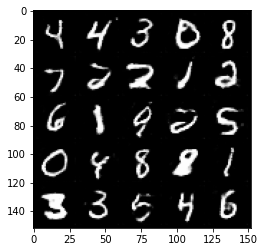

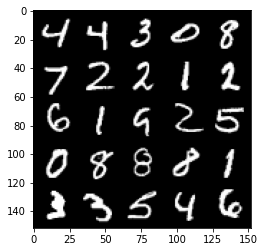

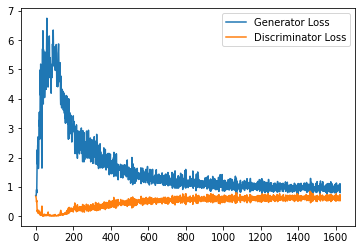

Step 33000: Generator loss: 0.9628148224353791, discriminator loss: 0.6156948705911637


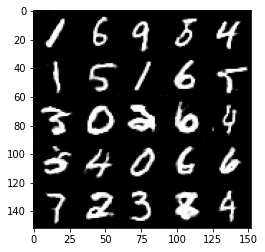

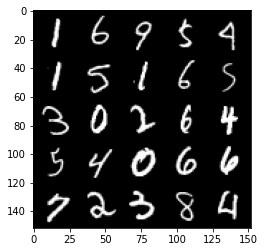

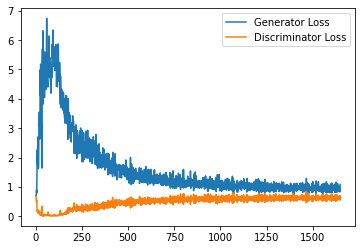

Step 33500: Generator loss: 0.9304388076066971, discriminator loss: 0.6244875157475471


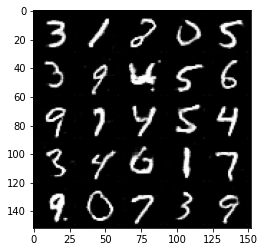

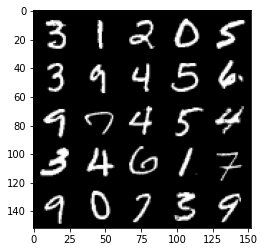

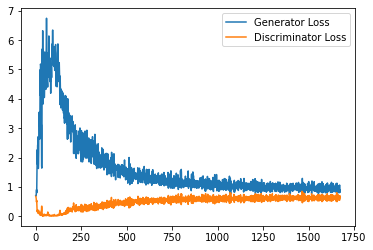

Step 34000: Generator loss: 0.9461429672241211, discriminator loss: 0.622963779091835


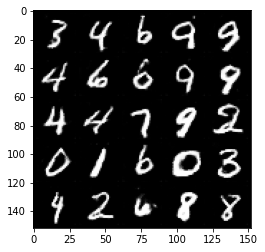

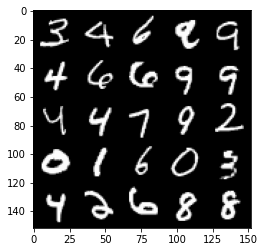

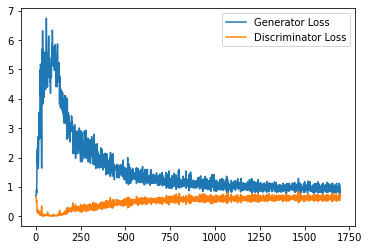

Step 34500: Generator loss: 0.9639025959968567, discriminator loss: 0.6200501870512962


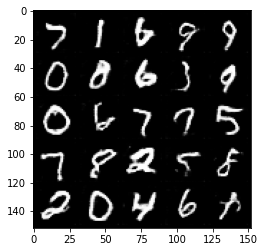

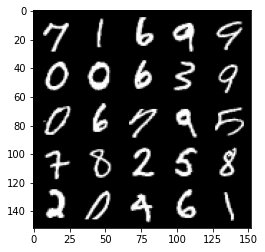

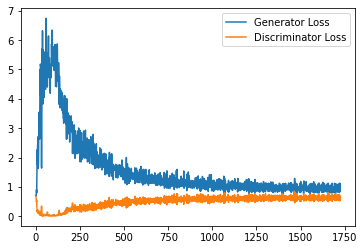

Step 35000: Generator loss: 0.935804449558258, discriminator loss: 0.623307269692421


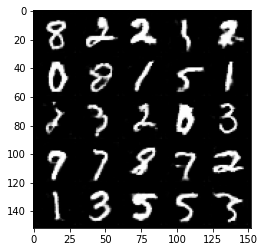

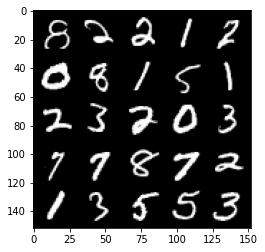

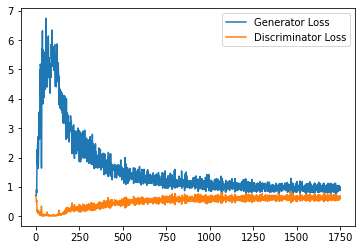

Step 35500: Generator loss: 0.9540610195994377, discriminator loss: 0.6200332536101342


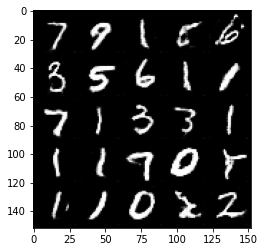

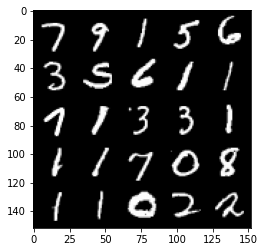

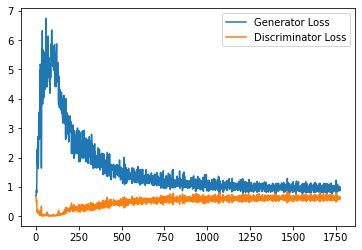

Step 36000: Generator loss: 0.929364510178566, discriminator loss: 0.6272700892090798


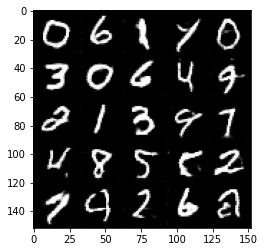

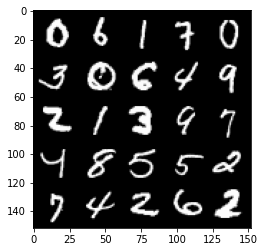

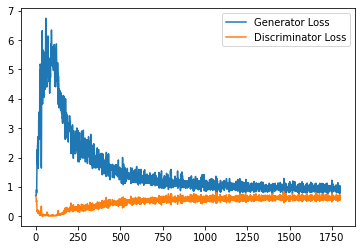

Step 36500: Generator loss: 0.942432543516159, discriminator loss: 0.6129591208696366


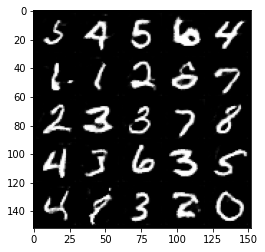

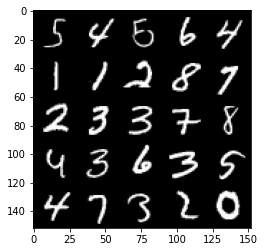

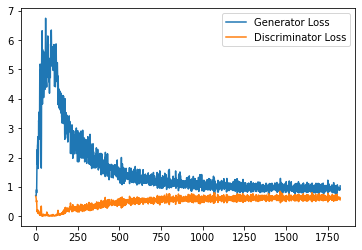

Step 37000: Generator loss: 0.9453250360488892, discriminator loss: 0.6205114240646362


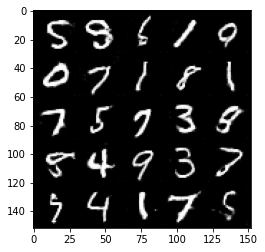

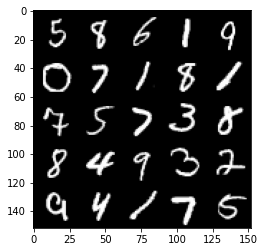

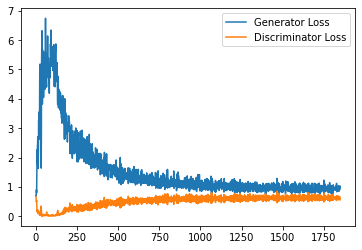

Step 37500: Generator loss: 0.9515897669792175, discriminator loss: 0.6178163041472435


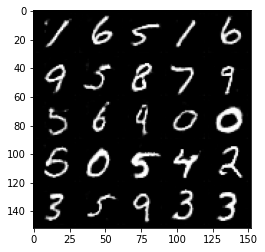

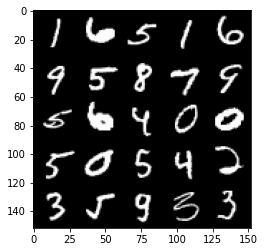

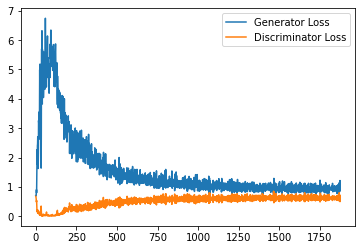

Step 38000: Generator loss: 0.9256668235063553, discriminator loss: 0.6236219125390052


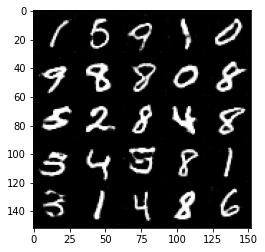

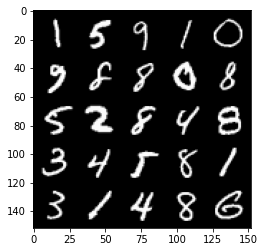

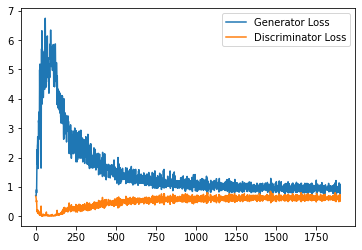

Step 38500: Generator loss: 0.9227829474210739, discriminator loss: 0.6226613914370537


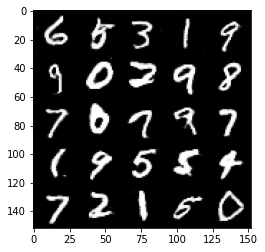

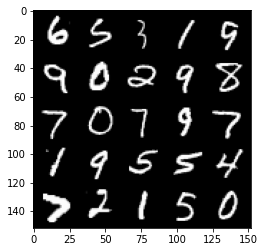

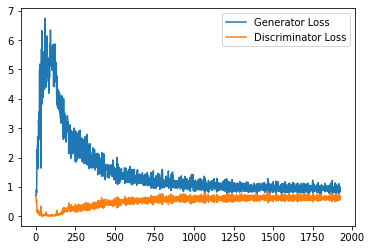

Step 39000: Generator loss: 0.9236501977443695, discriminator loss: 0.6203332500457763


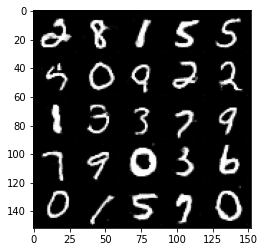

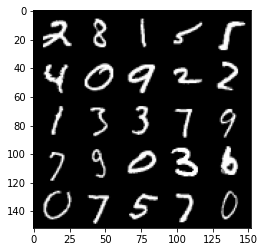

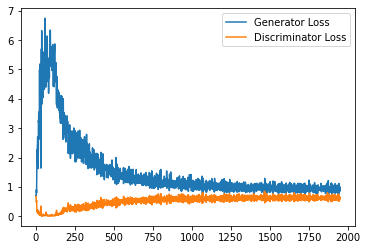

Step 39500: Generator loss: 0.9373808363676072, discriminator loss: 0.6229092080593109


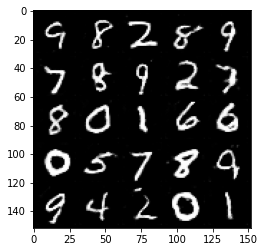

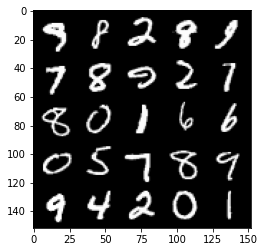

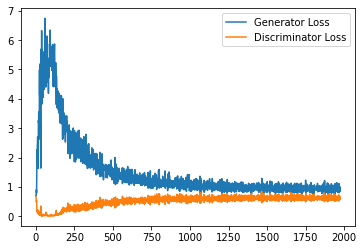

Step 40000: Generator loss: 0.9322577395439148, discriminator loss: 0.6159152187108994


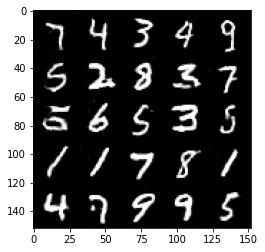

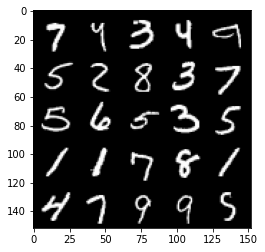

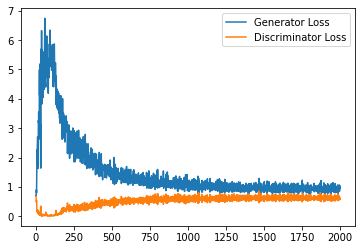

Step 40500: Generator loss: 0.9445941240787507, discriminator loss: 0.6193445671200752


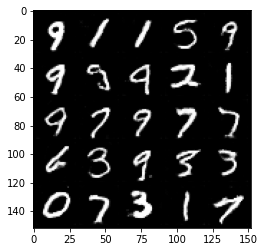

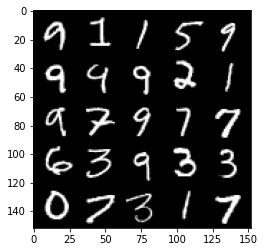

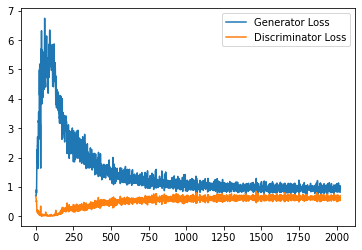

Step 41000: Generator loss: 0.930044374346733, discriminator loss: 0.6178779825568199


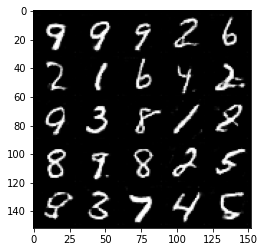

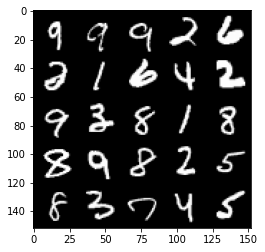

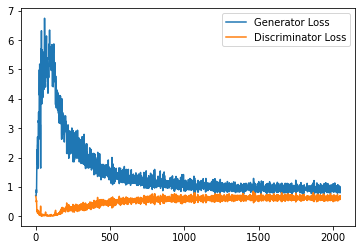

Step 41500: Generator loss: 0.9461052795648575, discriminator loss: 0.6118048359155654


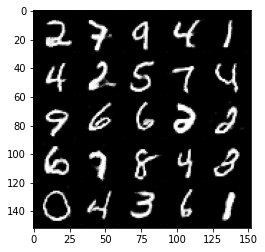

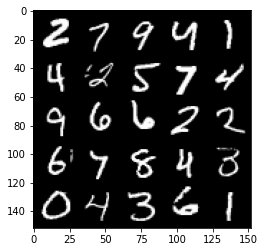

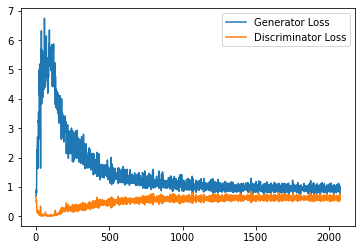

Step 42000: Generator loss: 0.9454532442092896, discriminator loss: 0.6227282068729401


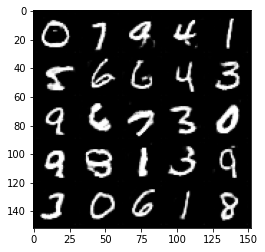

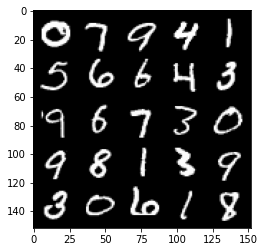

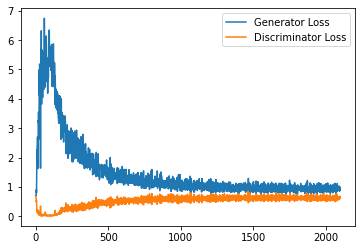

Step 42500: Generator loss: 0.9456993675231934, discriminator loss: 0.6183824492692948


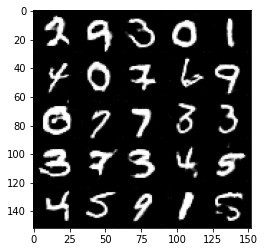

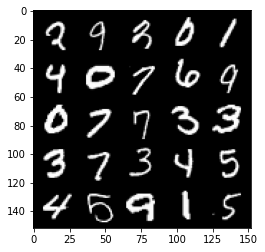

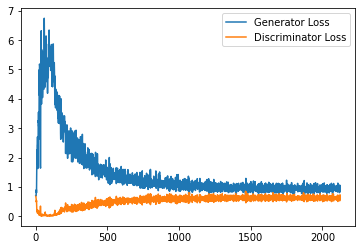

Step 43000: Generator loss: 0.9448516198396683, discriminator loss: 0.6157853808999062


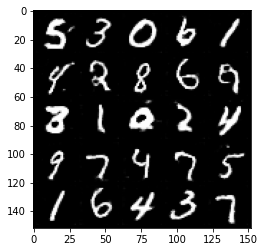

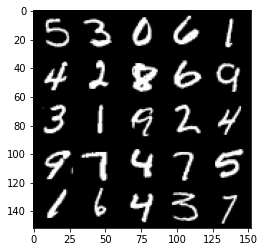

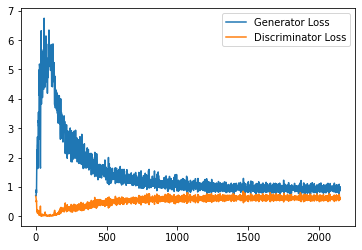

Step 43500: Generator loss: 0.92538576567173, discriminator loss: 0.6252413579821586


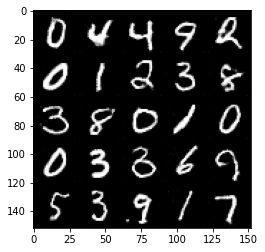

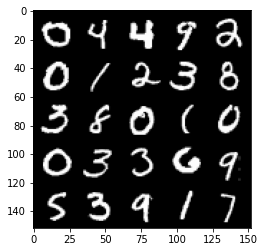

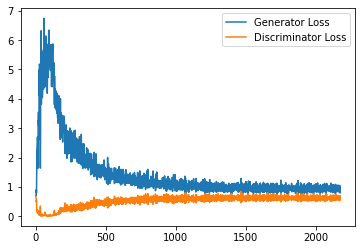

Step 44000: Generator loss: 0.9478744428157806, discriminator loss: 0.613181915640831


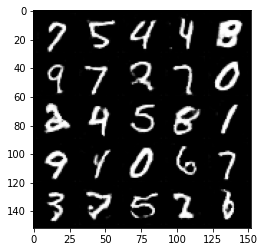

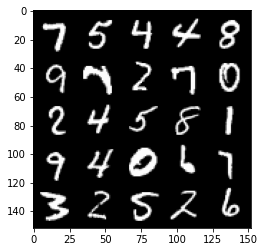

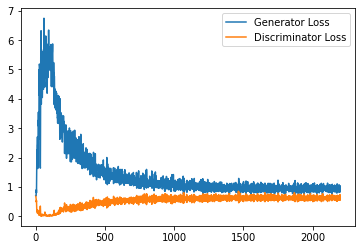

Step 44500: Generator loss: 0.9394990594387055, discriminator loss: 0.6185805384516716


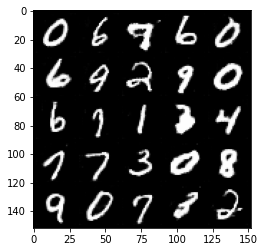

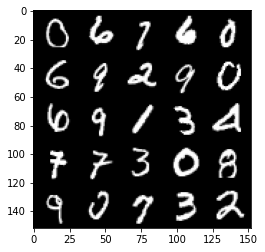

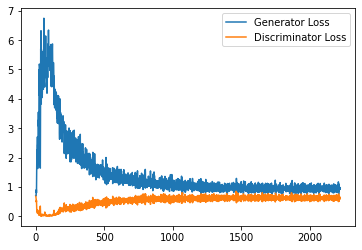

Step 45000: Generator loss: 0.9596236602067948, discriminator loss: 0.6148742678761482


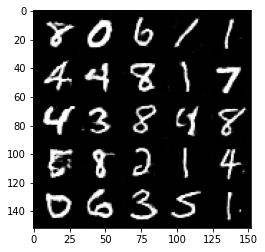

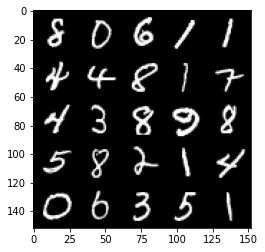

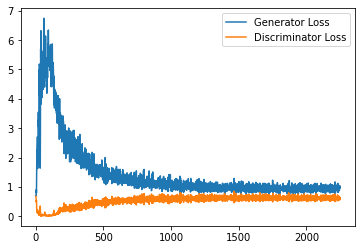

Step 45500: Generator loss: 0.9501467266082764, discriminator loss: 0.6242122696638107


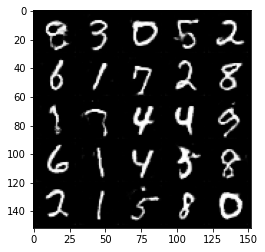

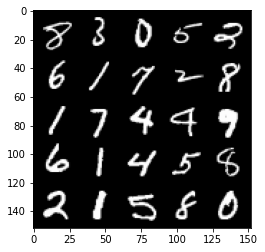

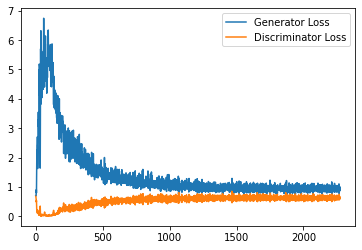

Step 46000: Generator loss: 0.9462643872499465, discriminator loss: 0.617678491294384


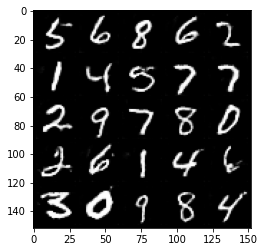

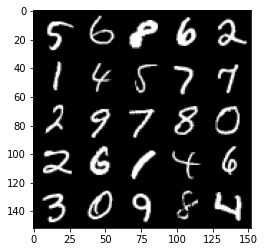

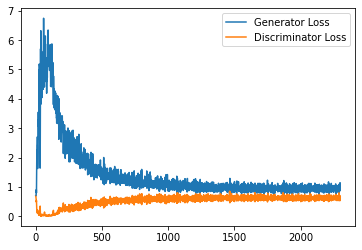

Step 46500: Generator loss: 0.9447648829221725, discriminator loss: 0.6185638818144799


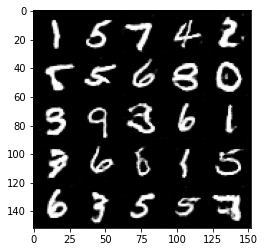

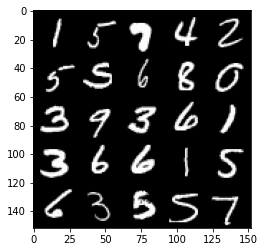

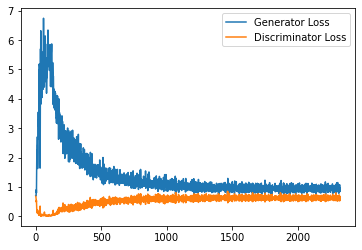

Step 47000: Generator loss: 0.9390394306182861, discriminator loss: 0.6163427300453186


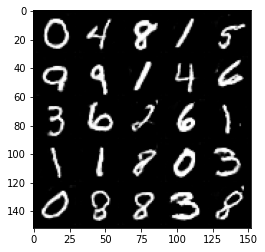

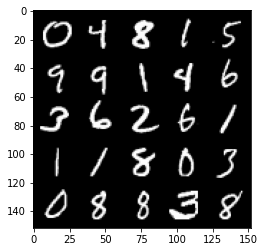

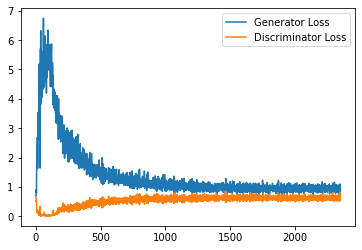

Step 47500: Generator loss: 0.9528389114141464, discriminator loss: 0.6094417563080787


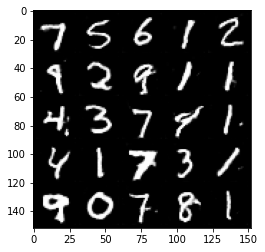

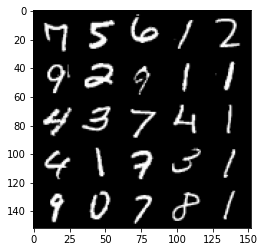

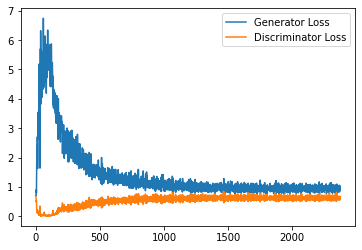

Step 48000: Generator loss: 0.9332630937099456, discriminator loss: 0.6138579187393188


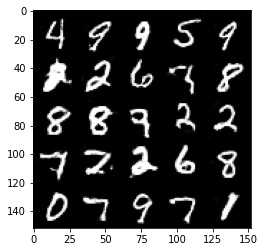

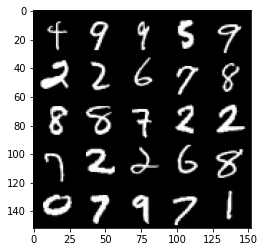

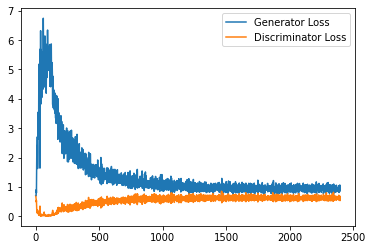

Step 48500: Generator loss: 0.9649529931545258, discriminator loss: 0.6142105929255486


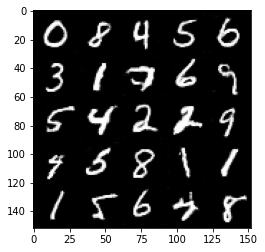

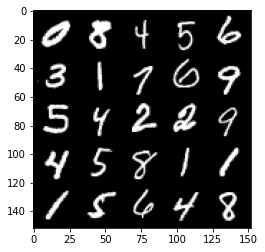

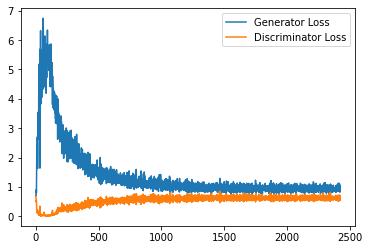

Step 49000: Generator loss: 0.9505211408138275, discriminator loss: 0.6143056888580323


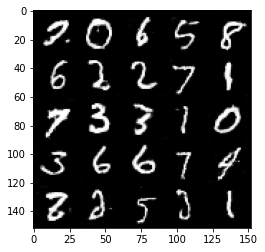

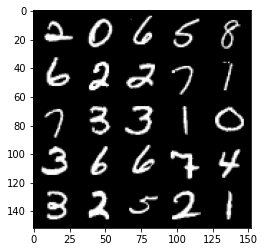

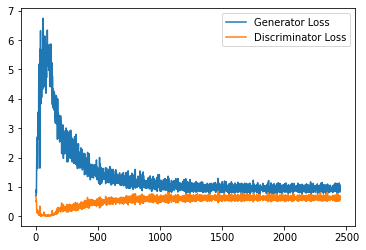

Step 49500: Generator loss: 0.9613119676113129, discriminator loss: 0.6081793341040611


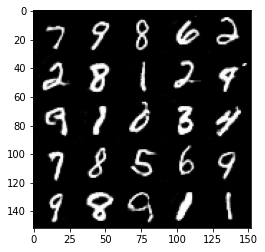

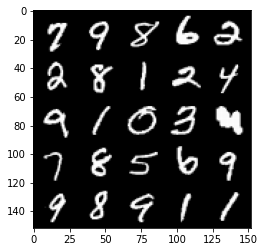

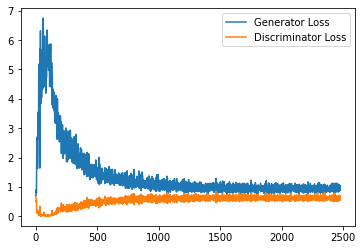

Step 50000: Generator loss: 0.9287438675165176, discriminator loss: 0.6090401638746261


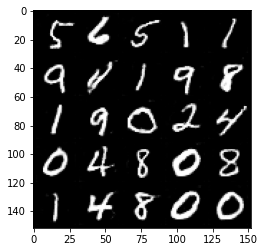

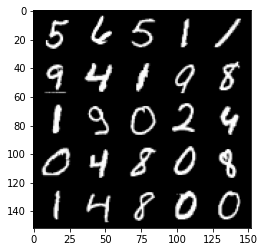

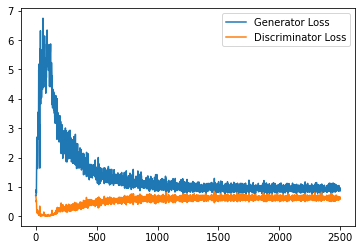

Step 50500: Generator loss: 0.9474209806919098, discriminator loss: 0.6062601032853127


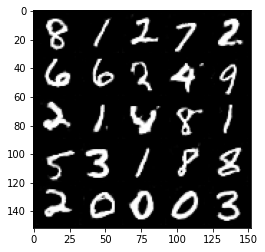

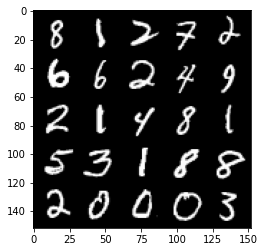

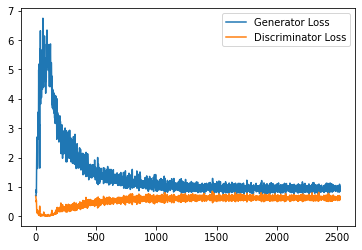

Step 51000: Generator loss: 0.943116769194603, discriminator loss: 0.6140416915416718


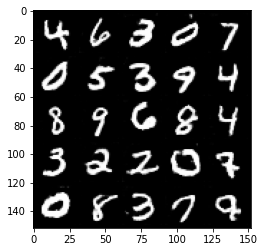

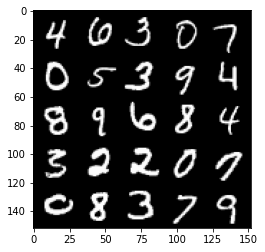

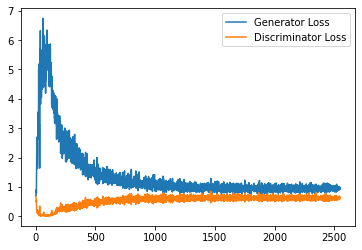

Step 51500: Generator loss: 0.9575132600069046, discriminator loss: 0.6037586454749108


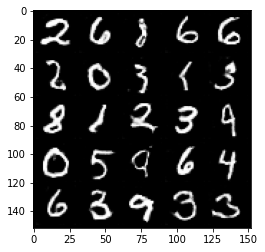

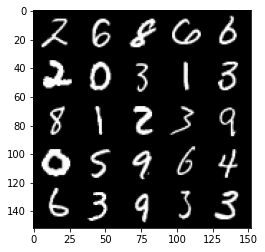

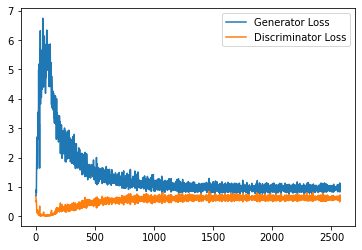

Step 52000: Generator loss: 0.9549594751596451, discriminator loss: 0.6109445128440857


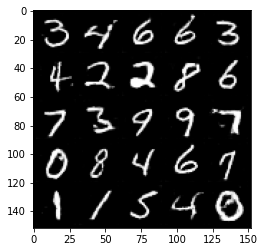

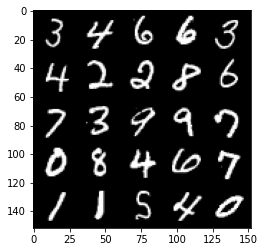

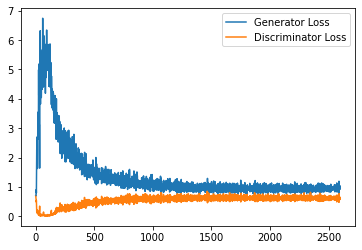

Step 52500: Generator loss: 0.9409778792858123, discriminator loss: 0.6114512327313423


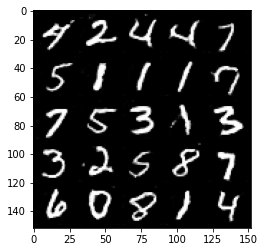

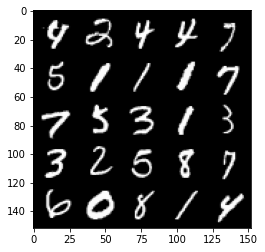

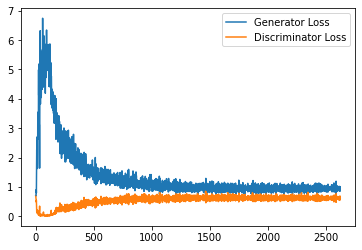

Step 53000: Generator loss: 0.9702790122032166, discriminator loss: 0.600173836171627


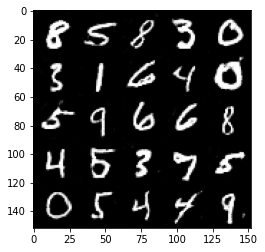

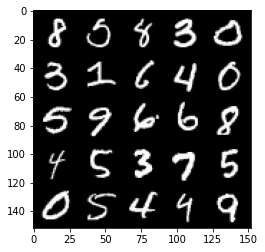

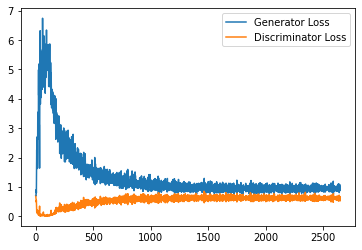

Step 53500: Generator loss: 0.9650724830627442, discriminator loss: 0.6088650864958763


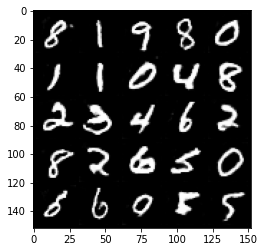

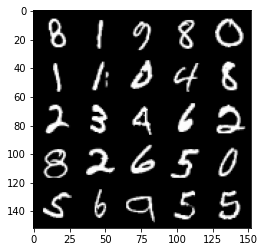

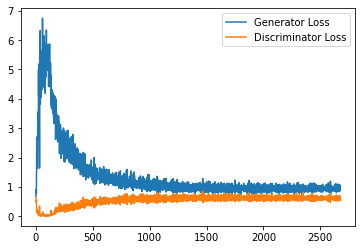

Step 54000: Generator loss: 0.9465999497175217, discriminator loss: 0.6026079375147819


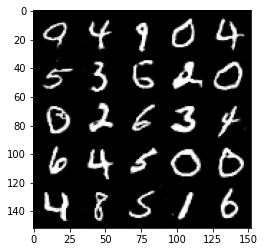

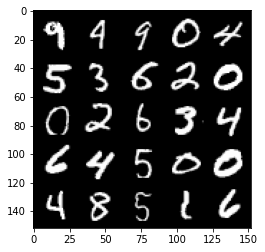

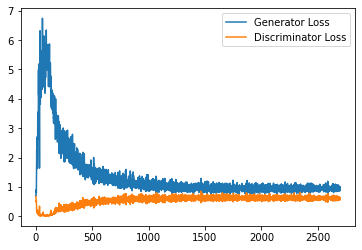

Step 54500: Generator loss: 0.9592947827577591, discriminator loss: 0.6022089581489563


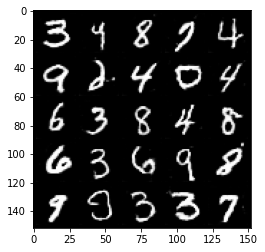

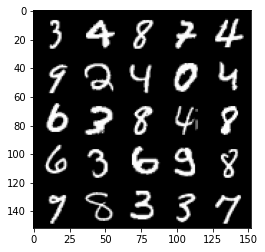

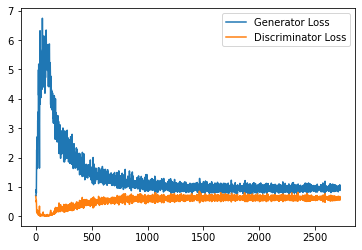

Step 55000: Generator loss: 0.9681058181524277, discriminator loss: 0.6097456426024437


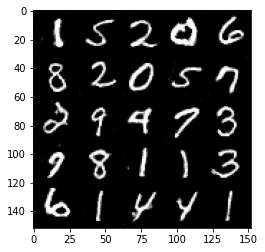

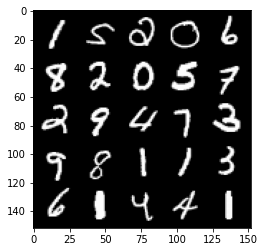

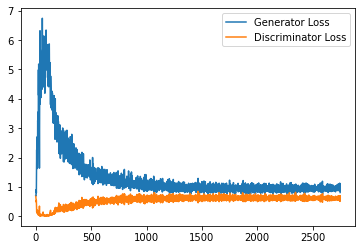

Step 55500: Generator loss: 0.9699120481014252, discriminator loss: 0.5995880920290947


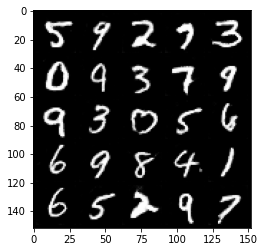

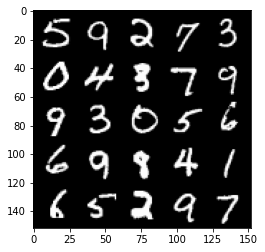

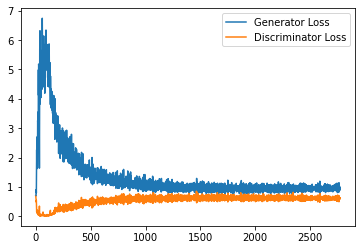

Step 56000: Generator loss: 0.9613364510536194, discriminator loss: 0.602201313316822


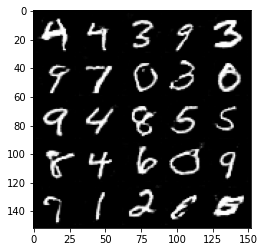

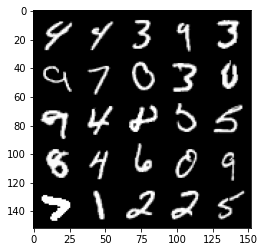

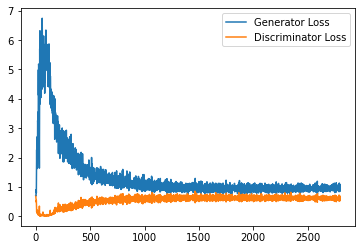

Step 56500: Generator loss: 0.9777308332920075, discriminator loss: 0.5985043293237686


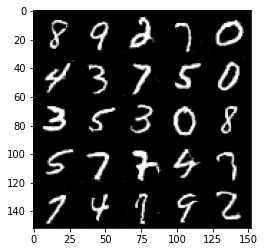

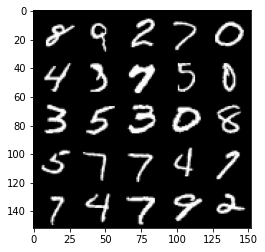

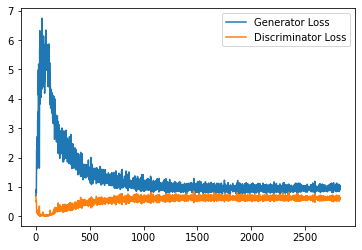

Step 57000: Generator loss: 0.9798083848953247, discriminator loss: 0.5978983736038208


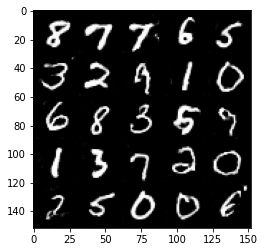

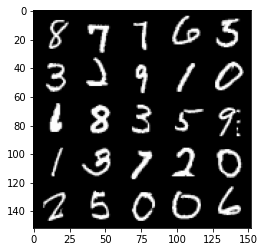

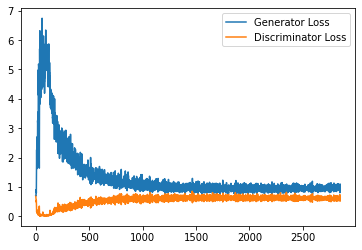

Step 57500: Generator loss: 0.9822400921583175, discriminator loss: 0.5972153888940811


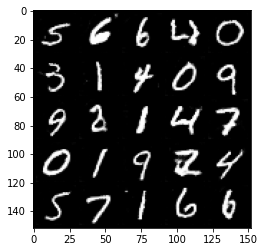

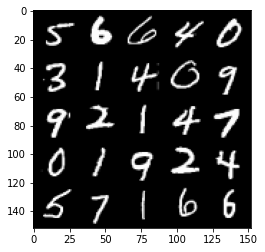

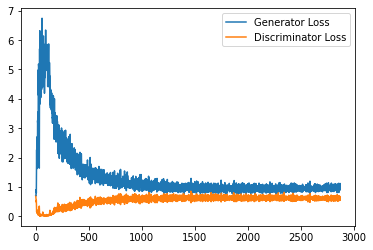

Step 58000: Generator loss: 0.9797831238508224, discriminator loss: 0.6015183519721031


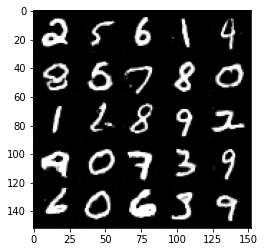

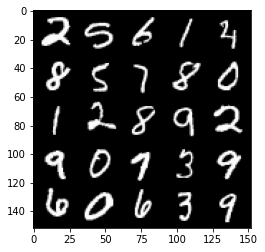

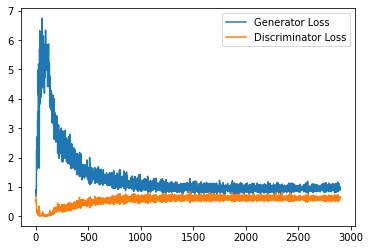

Step 58500: Generator loss: 0.9656403385400772, discriminator loss: 0.597329192340374


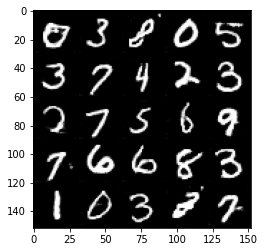

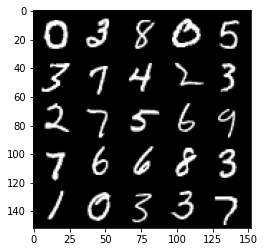

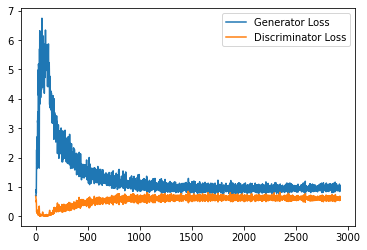

Step 59000: Generator loss: 0.98577512383461, discriminator loss: 0.5998130042552948


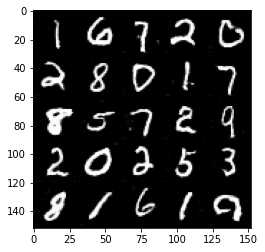

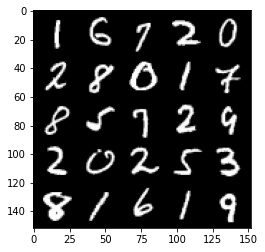

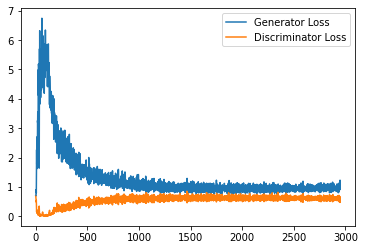

Step 59500: Generator loss: 0.9703585950136184, discriminator loss: 0.598372005879879


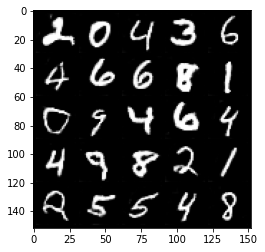

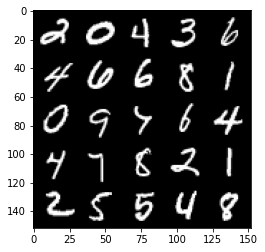

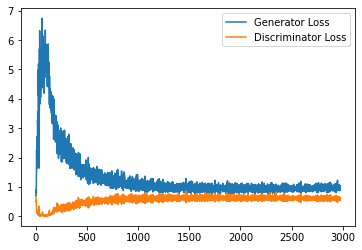

Step 60000: Generator loss: 0.9816519801616669, discriminator loss: 0.5945270836949349


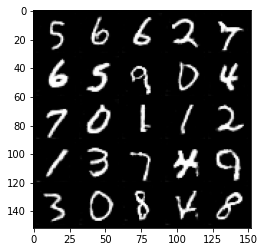

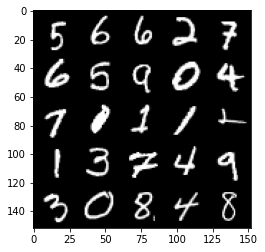

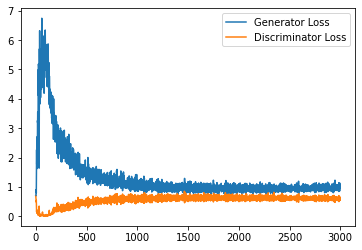

Step 60500: Generator loss: 0.9766150459051132, discriminator loss: 0.6045814230442047


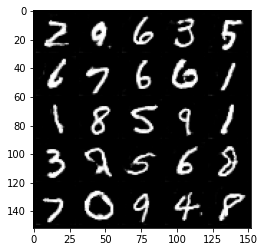

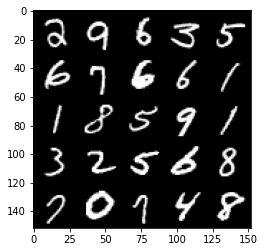

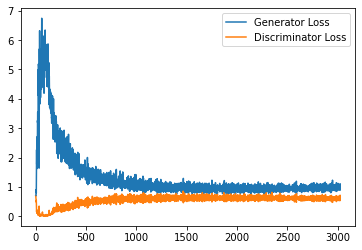

Step 61000: Generator loss: 0.9824572650194168, discriminator loss: 0.5929308595657349


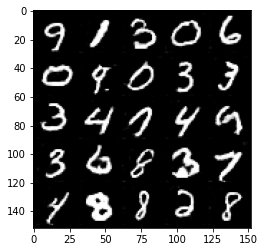

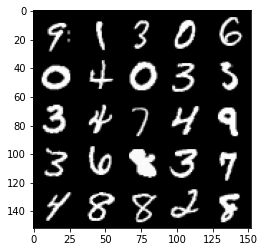

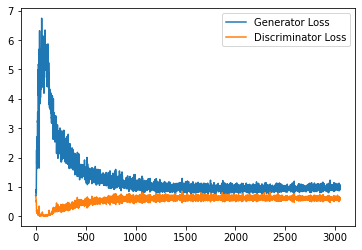

Step 61500: Generator loss: 0.9849425718784333, discriminator loss: 0.5942695340514184


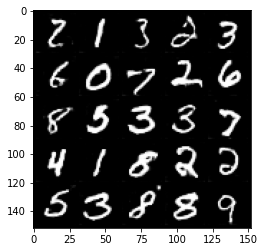

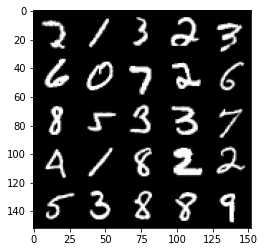

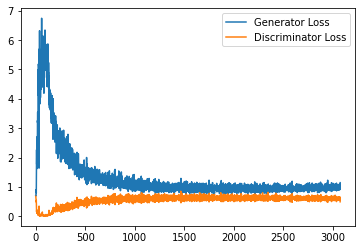

Step 62000: Generator loss: 0.9820958088636398, discriminator loss: 0.5931194672584533


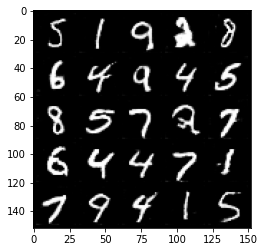

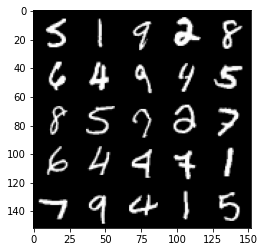

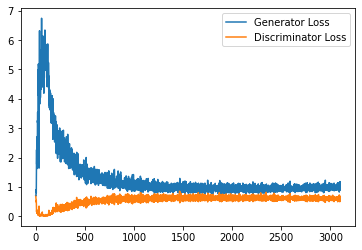

Step 62500: Generator loss: 0.996680252790451, discriminator loss: 0.5959803872108459


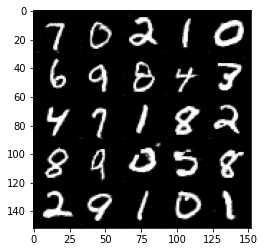

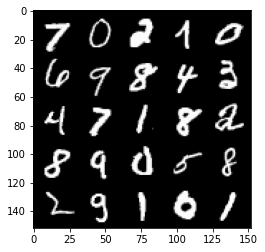

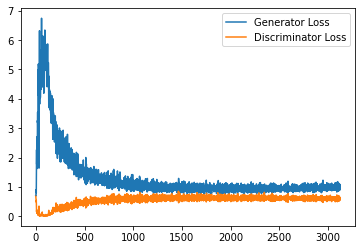

Step 63000: Generator loss: 0.9868487200737, discriminator loss: 0.5906012864112854


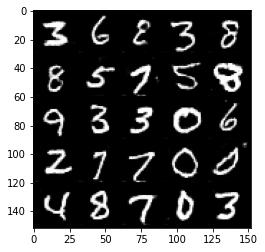

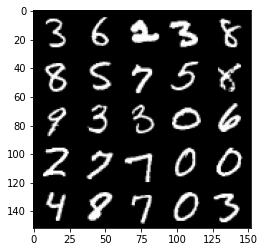

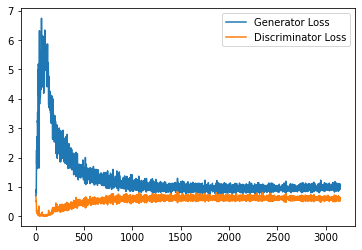

Step 63500: Generator loss: 0.9900284956693649, discriminator loss: 0.5927831638455391


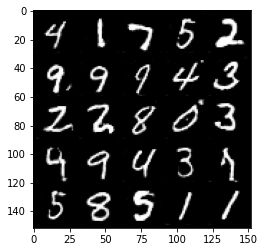

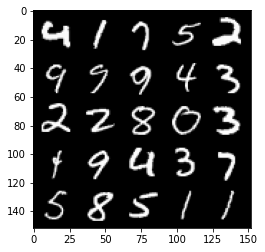

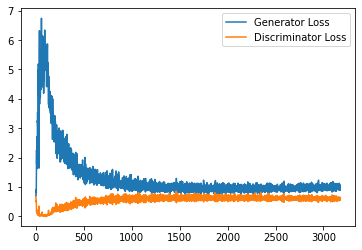

Step 64000: Generator loss: 0.9875835777521134, discriminator loss: 0.5925555936694146


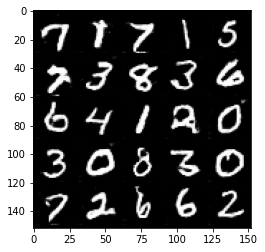

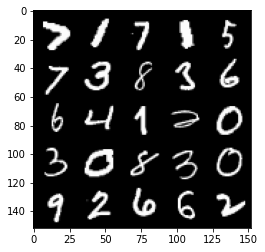

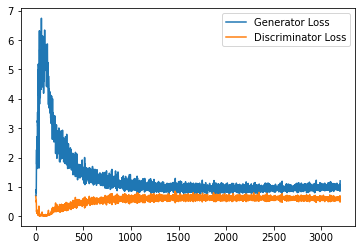

Step 64500: Generator loss: 0.987867753148079, discriminator loss: 0.5917335022687912


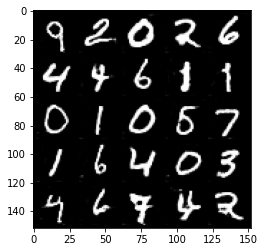

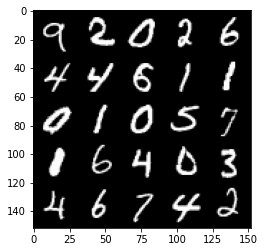

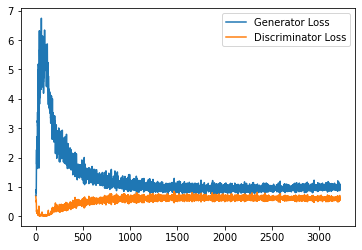

Step 65000: Generator loss: 1.002855474472046, discriminator loss: 0.5936923515796662


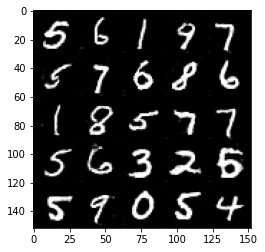

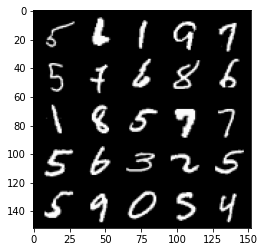

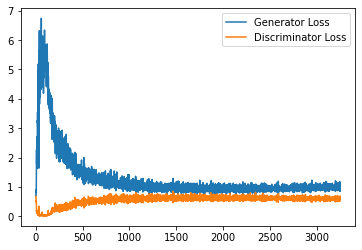

Step 65500: Generator loss: 0.9989500657320023, discriminator loss: 0.5876526995897293


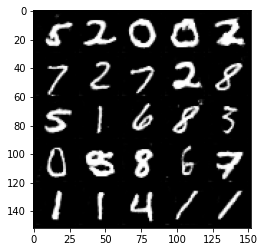

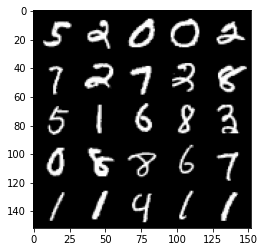

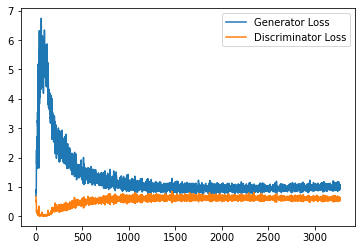

Step 66000: Generator loss: 1.010564563393593, discriminator loss: 0.5879912722110748


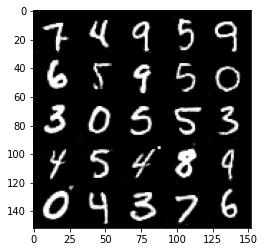

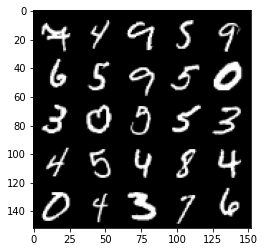

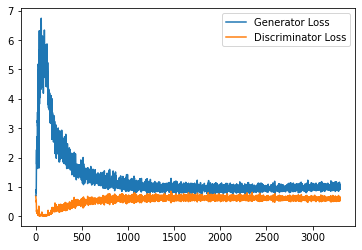

Step 66500: Generator loss: 0.9883172237873077, discriminator loss: 0.5900478886365891


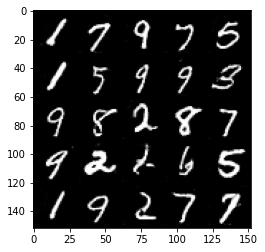

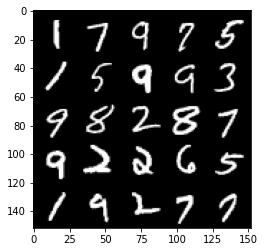

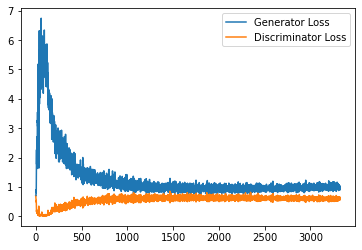

Step 67000: Generator loss: 1.0089443627595902, discriminator loss: 0.5837460971474647


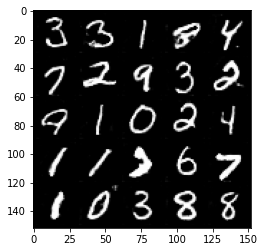

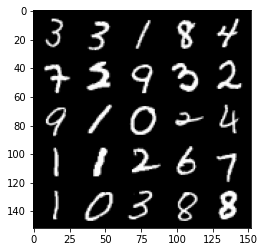

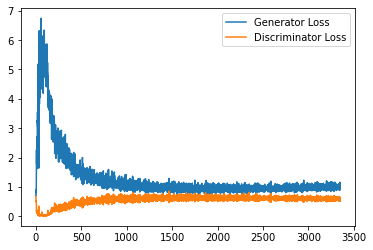

Step 67500: Generator loss: 1.0003841222524643, discriminator loss: 0.5866069239974022


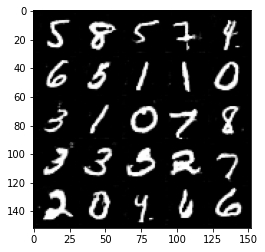

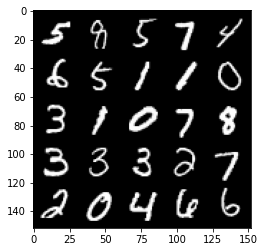

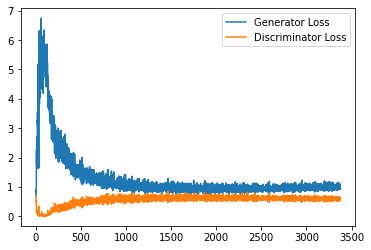

Step 68000: Generator loss: 1.0199443756341935, discriminator loss: 0.5813066785335541


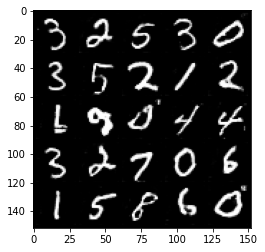

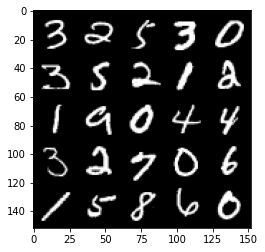

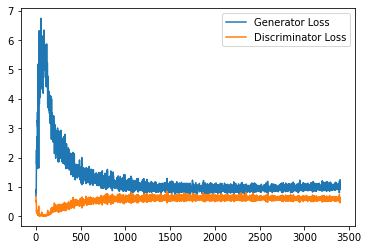

Step 68500: Generator loss: 1.001524338722229, discriminator loss: 0.5822462702393532


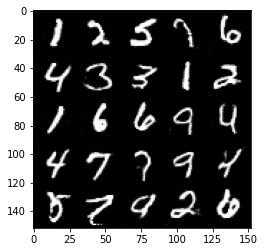

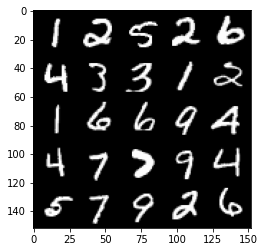

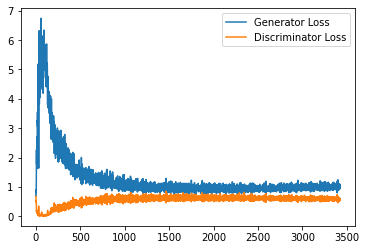

Step 69000: Generator loss: 1.0029285933971406, discriminator loss: 0.5826222401857376


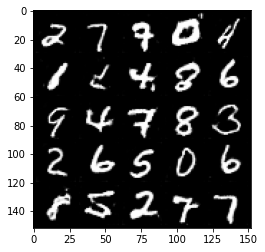

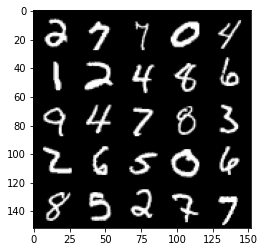

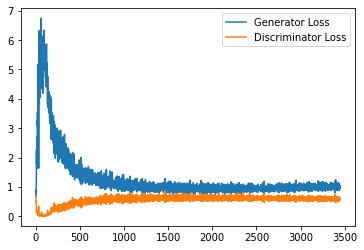

Step 69500: Generator loss: 1.0153610587120057, discriminator loss: 0.5880703036785125


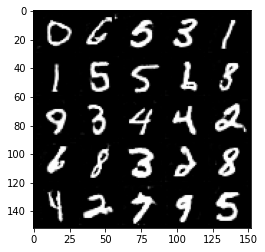

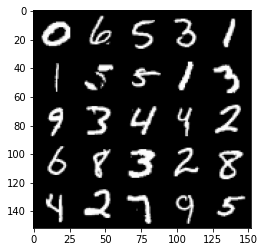

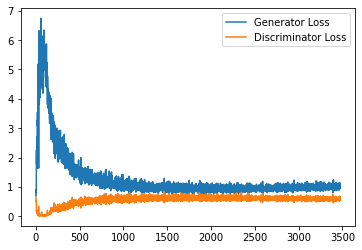

Step 70000: Generator loss: 0.9901857862472534, discriminator loss: 0.5827708612084389


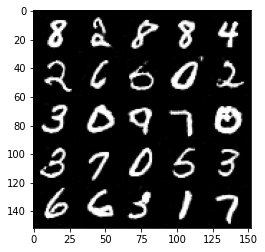

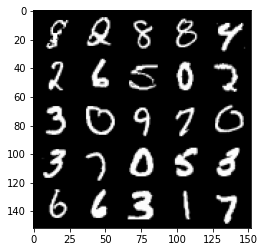

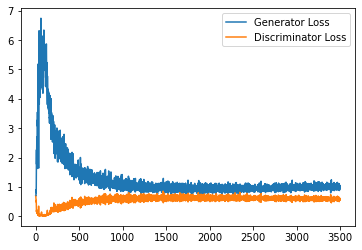

Step 70500: Generator loss: 1.0160152206420898, discriminator loss: 0.5824745264649391


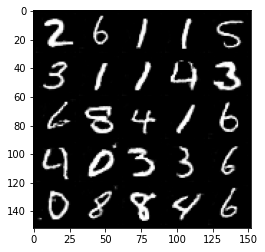

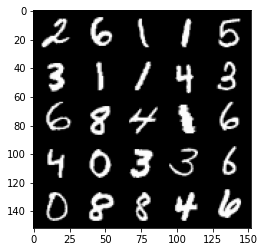

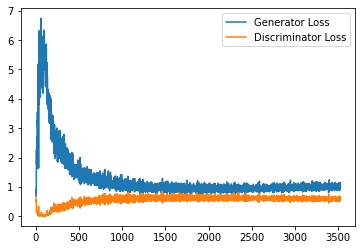

Step 71000: Generator loss: 1.00655721783638, discriminator loss: 0.5808022214770318


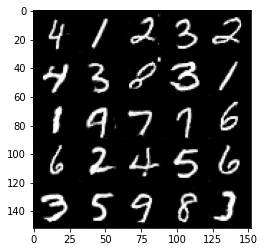

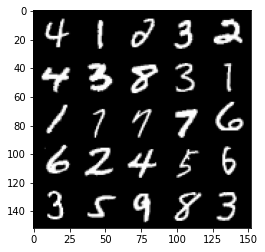

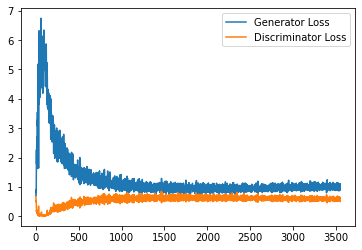

Step 71500: Generator loss: 1.0174114072322846, discriminator loss: 0.5850012372732163


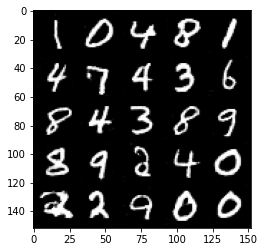

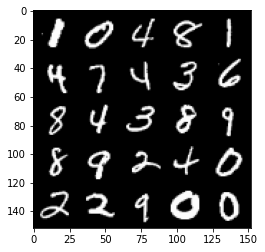

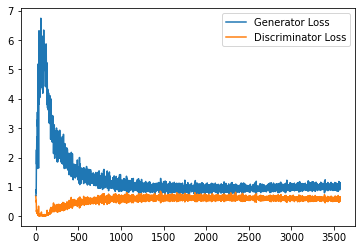

Step 72000: Generator loss: 1.0245502207279205, discriminator loss: 0.5769648738503456


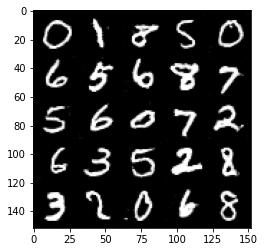

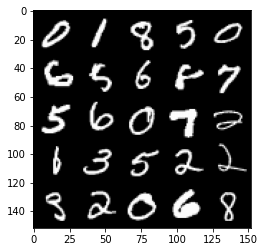

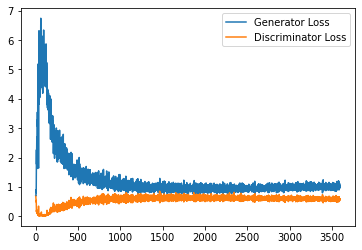

Step 72500: Generator loss: 1.0198544248342514, discriminator loss: 0.5820818149447441


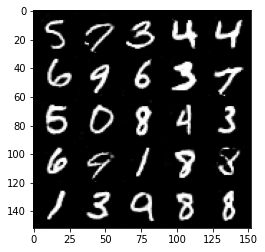

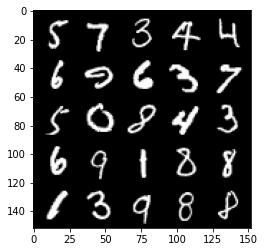

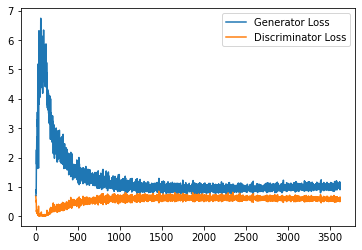

Step 73000: Generator loss: 1.028235867023468, discriminator loss: 0.5756341502666473


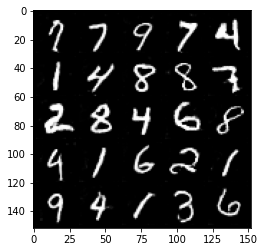

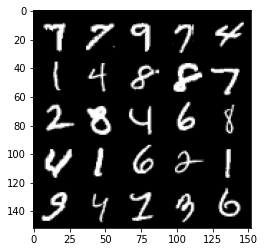

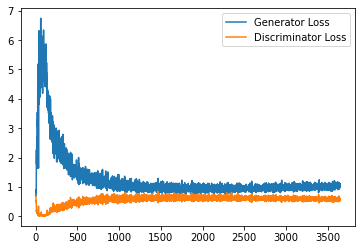

Step 73500: Generator loss: 1.011181057691574, discriminator loss: 0.5780491325855255


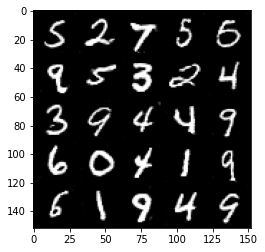

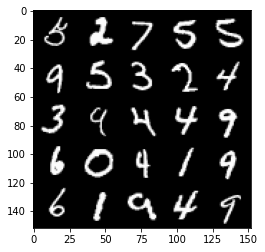

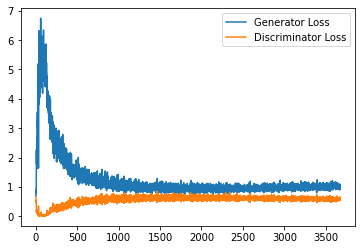

Step 74000: Generator loss: 1.0372576751708984, discriminator loss: 0.5737693129777909


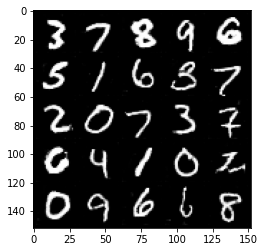

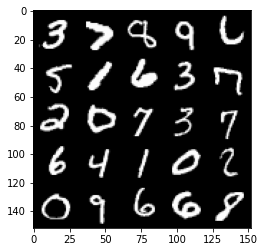

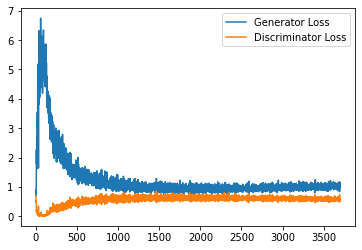

Step 74500: Generator loss: 1.0278292769193649, discriminator loss: 0.5821276062130928


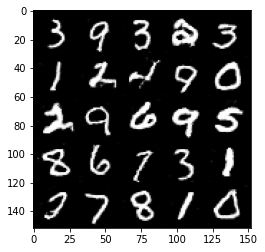

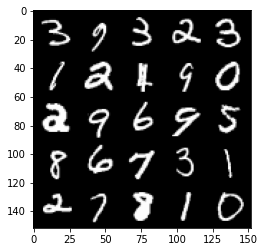

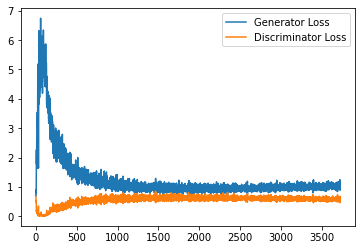

Step 75000: Generator loss: 1.0384654811620713, discriminator loss: 0.5731846142411232


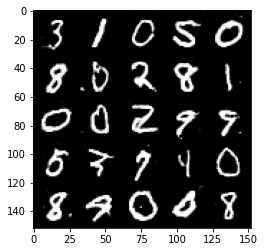

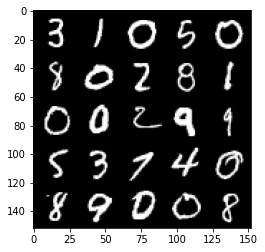

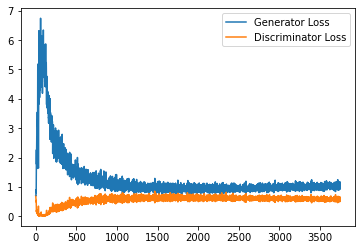

Step 75500: Generator loss: 1.030163554906845, discriminator loss: 0.5758927987217903


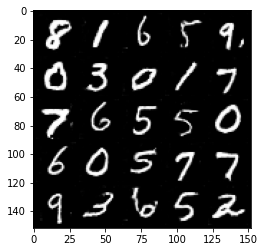

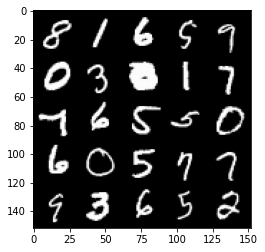

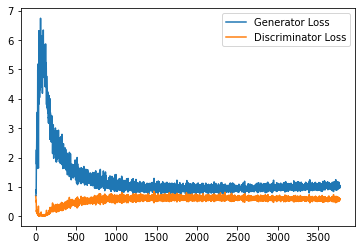

Step 76000: Generator loss: 1.0340940781831742, discriminator loss: 0.5834473201036453


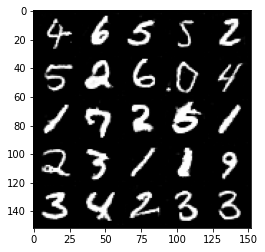

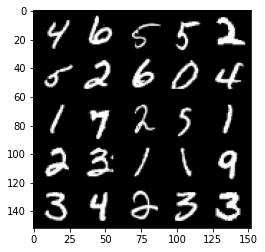

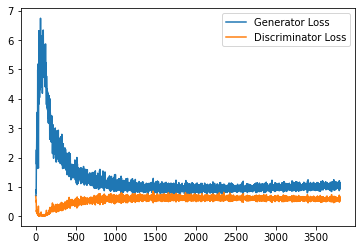

Step 76500: Generator loss: 1.0357181268930435, discriminator loss: 0.5771842135190963


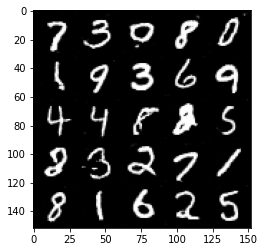

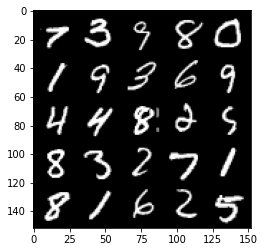

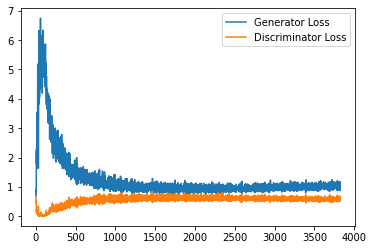

Step 77000: Generator loss: 1.0371174963712693, discriminator loss: 0.5782448933720589


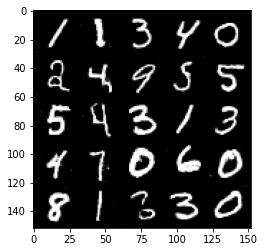

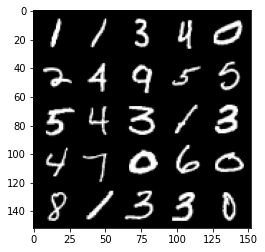

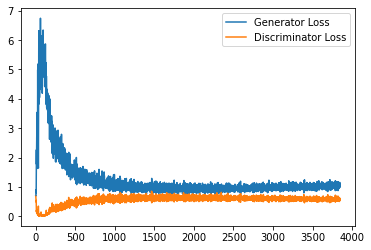

Step 77500: Generator loss: 1.0275029047727584, discriminator loss: 0.5795271516442299


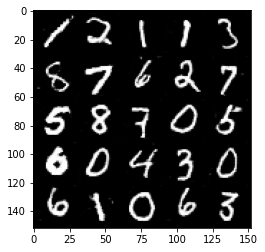

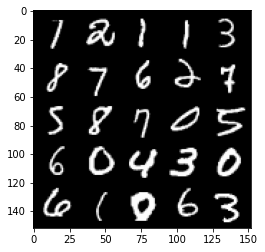

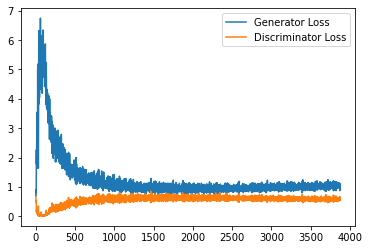

Step 78000: Generator loss: 1.0208964385986328, discriminator loss: 0.5720787193179131


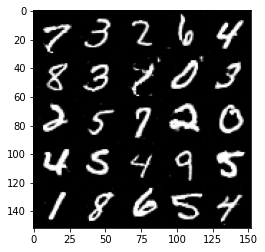

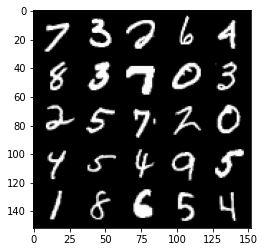

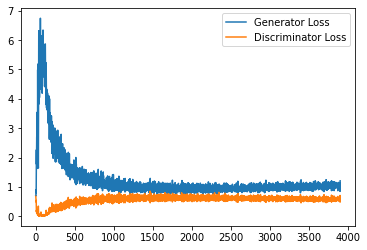

Step 78500: Generator loss: 1.0332785959243775, discriminator loss: 0.5839977014660835


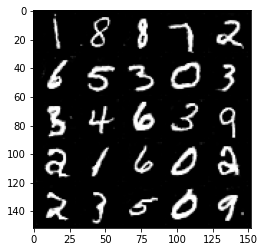

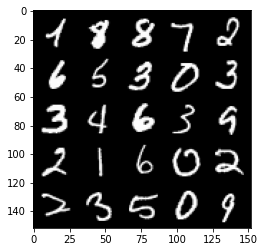

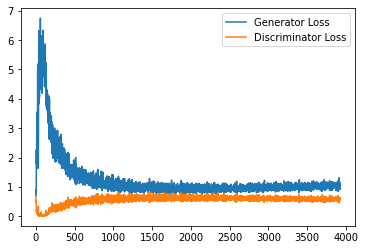

Step 79000: Generator loss: 1.0366299875974656, discriminator loss: 0.5785614445805549


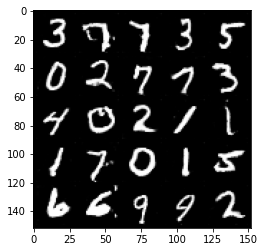

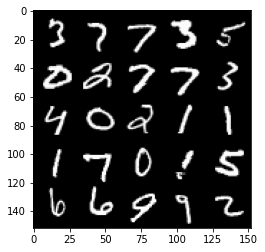

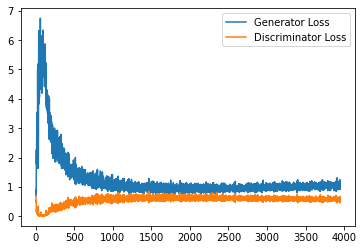

Step 79500: Generator loss: 1.038824679851532, discriminator loss: 0.5828011267185211


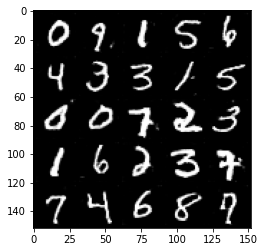

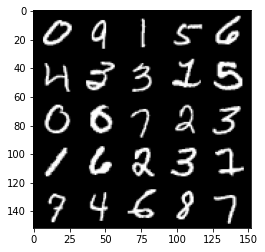

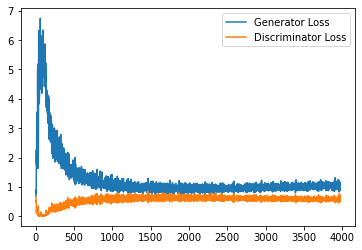

Step 80000: Generator loss: 1.021077782392502, discriminator loss: 0.5816302272677422


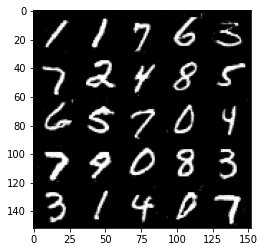

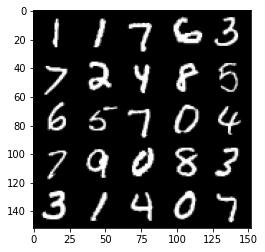

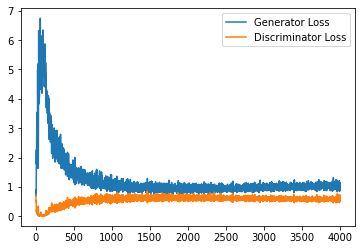

Step 80500: Generator loss: 1.0283950852155685, discriminator loss: 0.5806698358654976


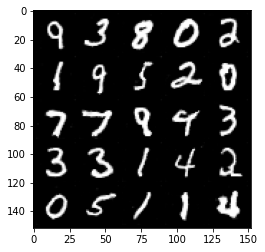

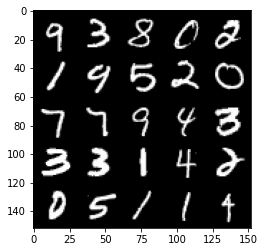

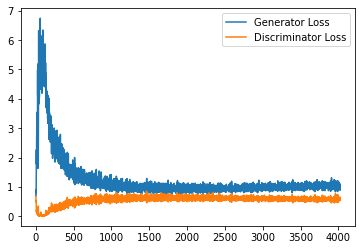

Step 81000: Generator loss: 1.0115248572826385, discriminator loss: 0.588036179959774


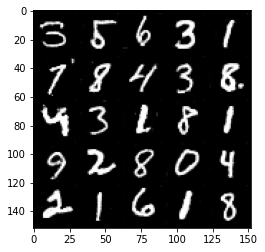

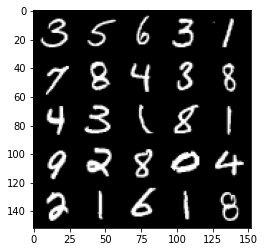

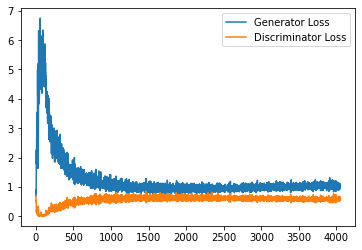

Step 81500: Generator loss: 1.0267928762435914, discriminator loss: 0.5839729477167129


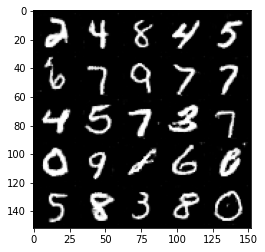

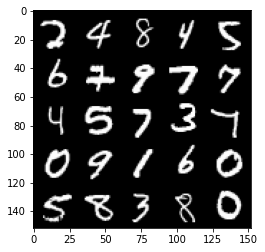

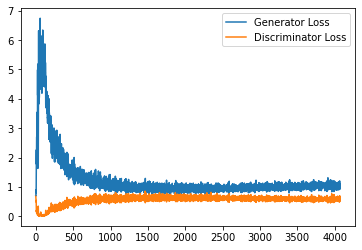

Step 82000: Generator loss: 1.0285758525133133, discriminator loss: 0.5764691578745842


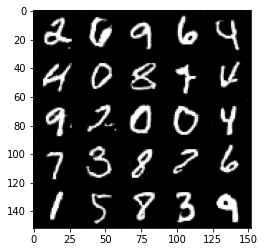

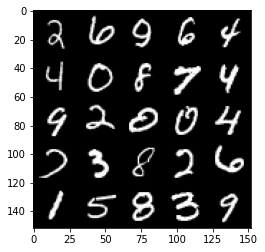

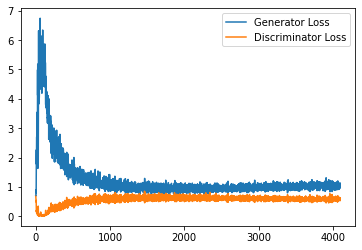

Step 82500: Generator loss: 1.0268759841918946, discriminator loss: 0.589383892416954


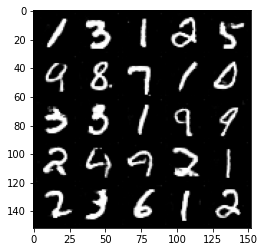

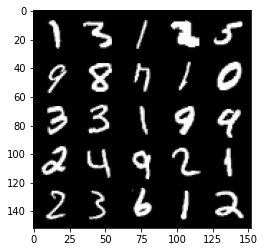

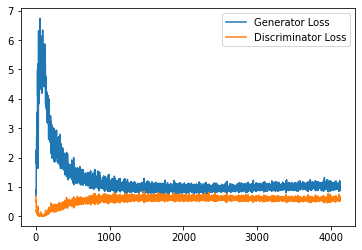

Step 83000: Generator loss: 1.0242478411197662, discriminator loss: 0.5842051299214364


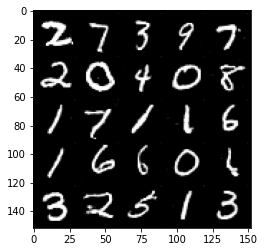

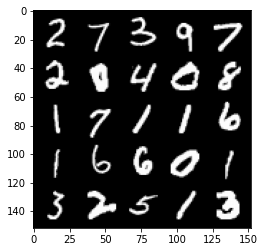

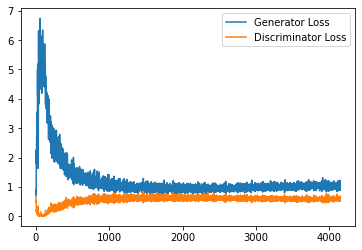

Step 83500: Generator loss: 1.0283860599994659, discriminator loss: 0.5840909036397934


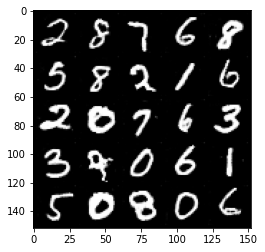

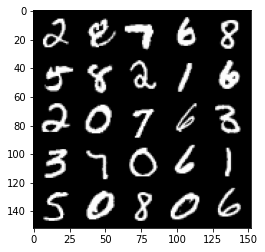

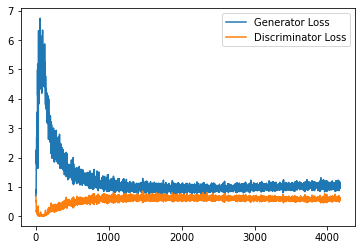

Step 84000: Generator loss: 1.0230374298095704, discriminator loss: 0.5845054243206977


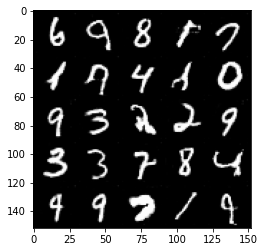

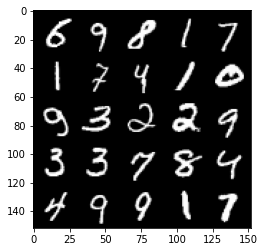

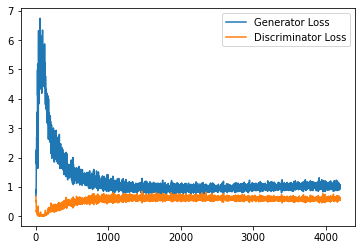

Step 84500: Generator loss: 1.009482927441597, discriminator loss: 0.5918095366954803


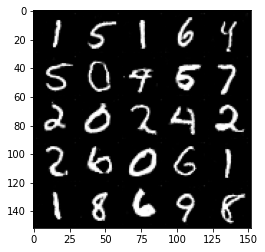

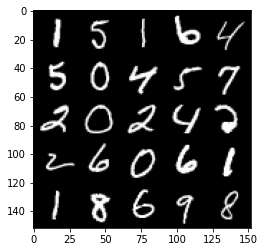

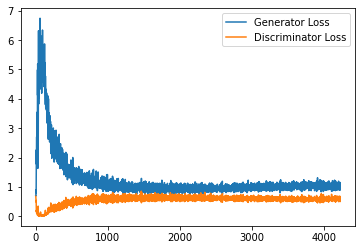

Step 85000: Generator loss: 1.0257655087709427, discriminator loss: 0.582954020023346


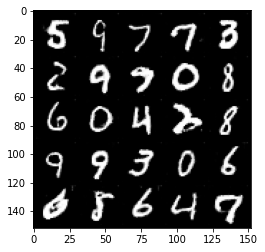

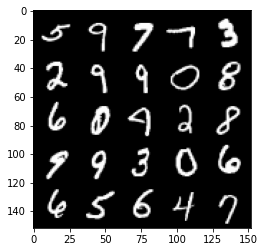

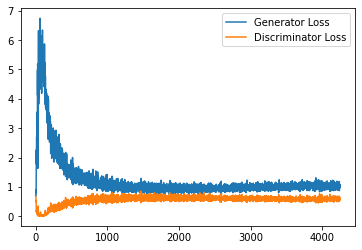

Step 85500: Generator loss: 1.020578508377075, discriminator loss: 0.5854385106563568


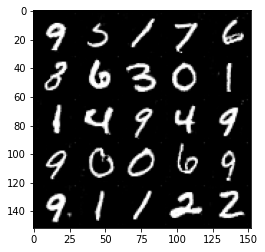

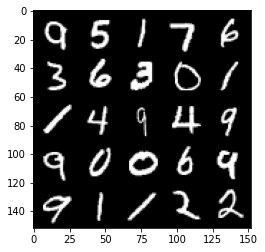

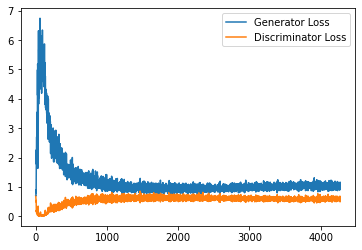

Step 86000: Generator loss: 1.0217914744615555, discriminator loss: 0.5890421063899994


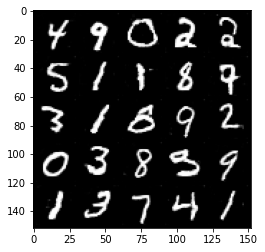

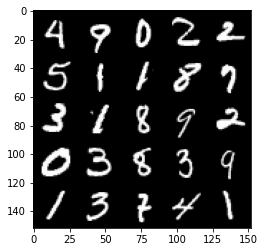

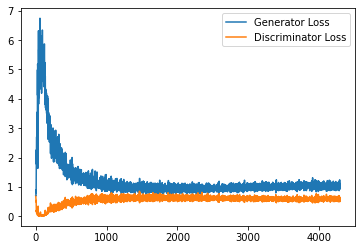

Step 86500: Generator loss: 1.0367377059459686, discriminator loss: 0.5835922979712487


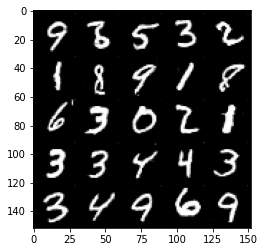

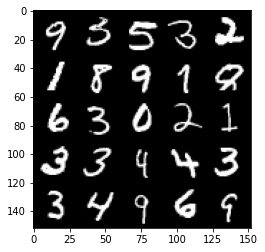

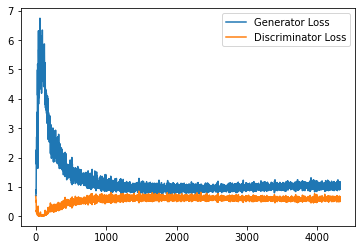

Step 87000: Generator loss: 1.0292156939506532, discriminator loss: 0.585622535943985


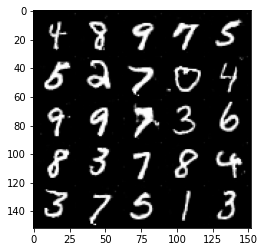

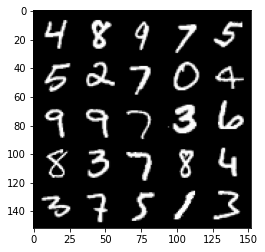

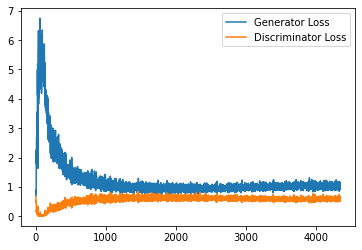

Step 87500: Generator loss: 1.0223385537862777, discriminator loss: 0.5887010152935982


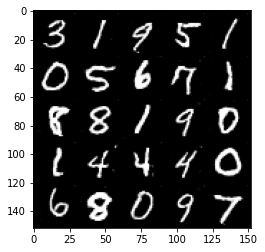

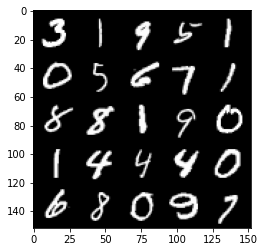

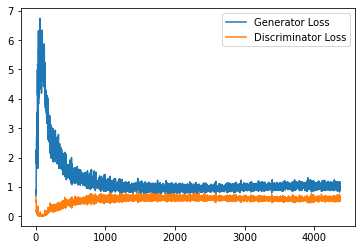

Step 88000: Generator loss: 1.0158609738349915, discriminator loss: 0.5880848572850227


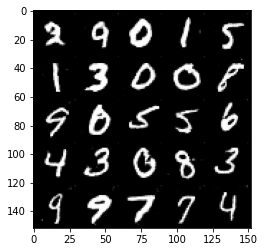

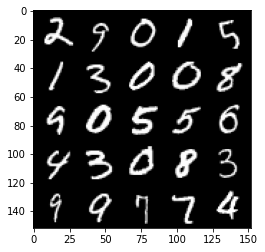

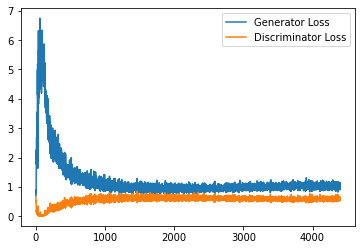

Step 88500: Generator loss: 1.0226838958263398, discriminator loss: 0.5880555427074432


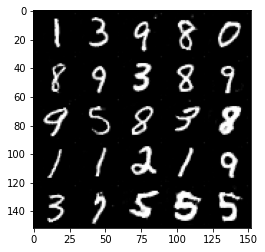

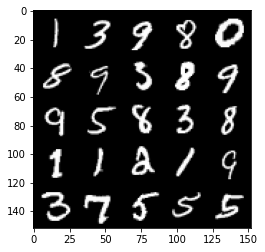

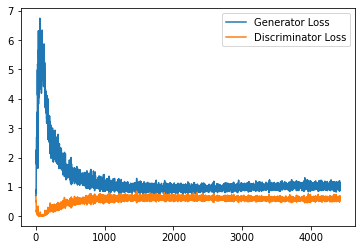

Step 89000: Generator loss: 1.0250578697919845, discriminator loss: 0.5878099588751793


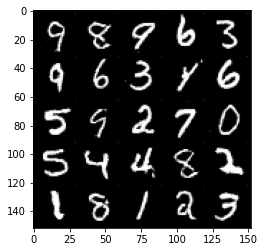

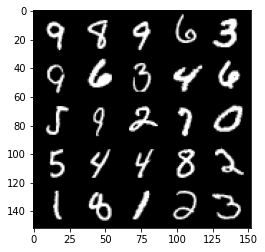

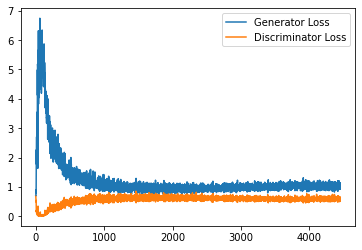

Step 89500: Generator loss: 1.023045113325119, discriminator loss: 0.5924778074026108


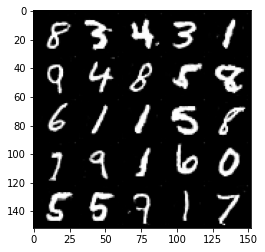

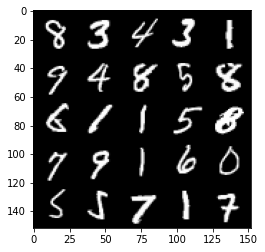

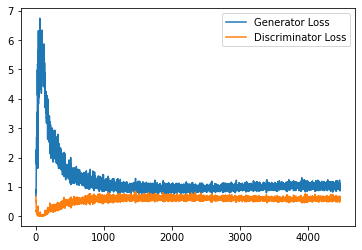

Step 90000: Generator loss: 1.0002945644855499, discriminator loss: 0.5866429263949394


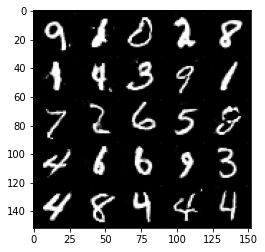

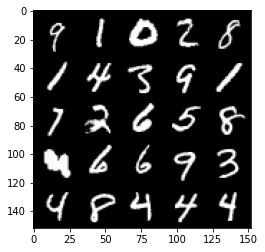

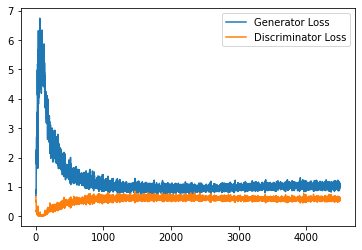

Step 90500: Generator loss: 1.0215443900823593, discriminator loss: 0.5933114051222801


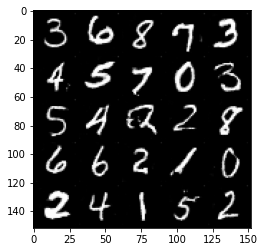

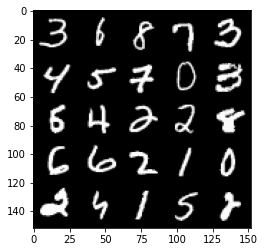

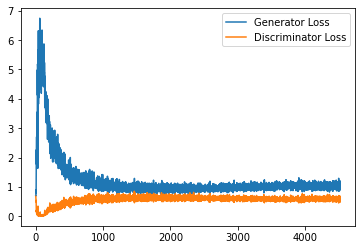

Step 91000: Generator loss: 1.0034221335649491, discriminator loss: 0.5952125619053841


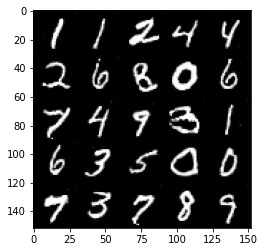

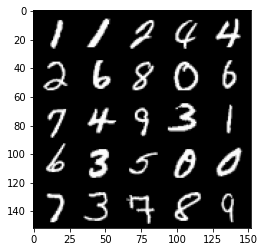

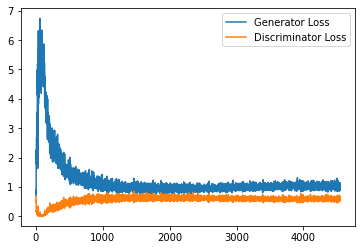

Step 91500: Generator loss: 1.022772603392601, discriminator loss: 0.5911277729868889


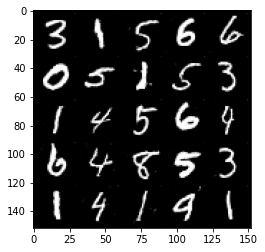

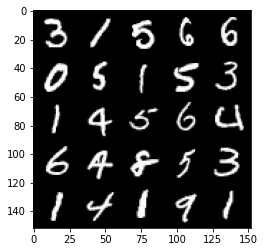

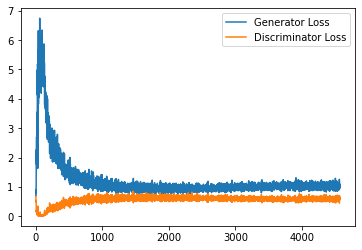

Step 92000: Generator loss: 1.002599100589752, discriminator loss: 0.5941423336267472


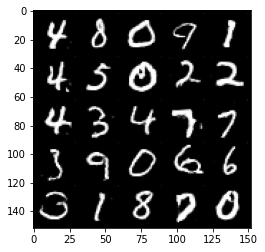

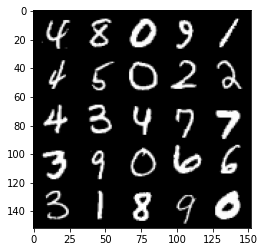

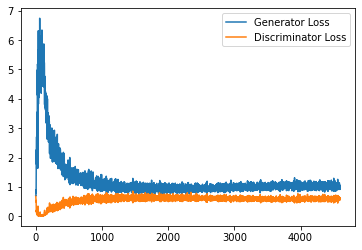

Step 92500: Generator loss: 0.9934266514778137, discriminator loss: 0.5955013716816903


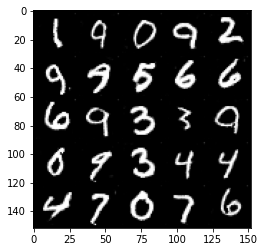

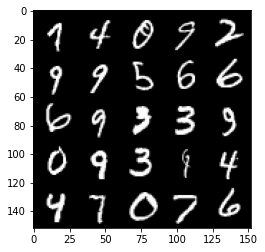

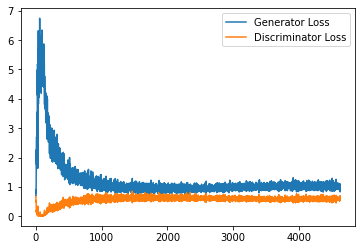

Step 93000: Generator loss: 1.0142660545110702, discriminator loss: 0.5926779637932778


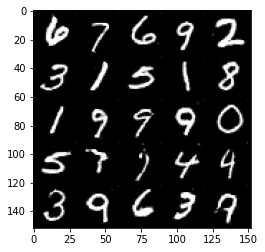

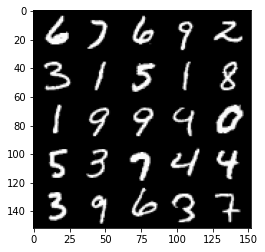

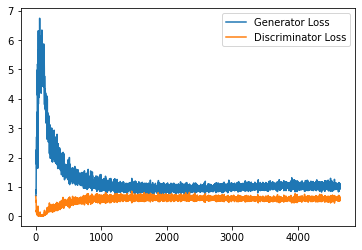

Step 93500: Generator loss: 1.0107088996171951, discriminator loss: 0.5941775230169296


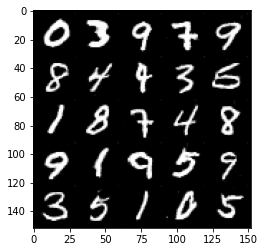

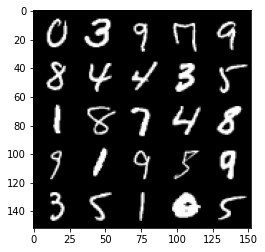

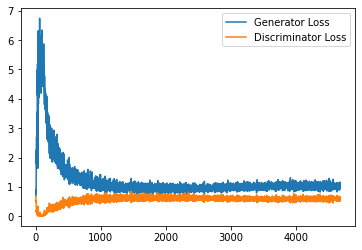

In [51]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels)
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [ ]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

In [ ]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

In [ ]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()